In [14]:
import numpy as np 
import pandas as pd


import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import scipy.stats as stats

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from IPython.display import Image


import statsmodels.api as sma

from sklearn.preprocessing import StandardScaler, PowerTransformer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error
from sklearn.pipeline import make_pipeline,Pipeline
from sklearn.model_selection import GridSearchCV

from sklearn.feature_selection import RFE
from sklearn.model_selection import KFold
from sklearn.model_selection import LeaveOneOut
from statsmodels.stats.outliers_influence import variance_inflation_factor

import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
from sklearn.linear_model import Lasso,Ridge,ElasticNet,SGDRegressor
import statsmodels.stats.api as ssa
from statsmodels.stats.stattools import durbin_watson
from statsmodels.stats.outliers_influence import variance_inflation_factor
#from mlxtend.feature_selection import SequentialFeatureSelector

import warnings
warnings.filterwarnings('ignore')

pd.options.display.max_columns = None

In [161]:
df=pd.read_csv("media prediction and its cost.csv")
df.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg_cars_at home(approx),avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type,cost
0,Breakfast Foods,Frozen Foods,Food,7.36,2.7232,4.0,Bag Stuffers,USA,M,F,1.0,Partial High School,Normal,Skilled Manual,Y,1.0,$10K - $30K,1.0,1.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,"Daily Paper, Radio",126.62
1,Breakfast Foods,Frozen Foods,Food,5.52,2.5944,3.0,Cash Register Lottery,USA,M,M,0.0,Bachelors Degree,Silver,Professional,Y,4.0,$50K - $70K,0.0,4.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,"Daily Paper, Radio",59.86
2,Breakfast Foods,Frozen Foods,Food,3.68,1.3616,2.0,High Roller Savings,USA,S,F,4.0,Partial High School,Normal,Manual,N,1.0,$10K - $30K,0.0,1.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,"Daily Paper, Radio",84.16
3,Breakfast Foods,Frozen Foods,Food,3.68,1.1776,2.0,Cash Register Lottery,USA,M,F,2.0,High School Degree,Bronze,Manual,Y,2.0,$30K - $50K,2.0,2.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,In-Store Coupon,95.78
4,Breakfast Foods,Frozen Foods,Food,4.08,1.4280,3.0,Double Down Sale,USA,M,M,0.0,Partial High School,Bronze,Skilled Manual,N,2.0,$30K - $50K,0.0,2.0,Golden,1.36,7.12,5.11,0.0,1.0,29.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,Radio,50.79


In [97]:
df.shape

(60428, 40)

# READ DATASET

In [4]:
#df = pd.read_csv(r"C:\Users\K\Downloads\Great Learning\Project\Dataset\media prediction and its cost.csv")
#df.head()

In [98]:
df.shape

(60428, 40)

# CHECK DATATYPES

In [99]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60428 entries, 0 to 60427
Data columns (total 40 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   food_category               60428 non-null  object 
 1   food_department             60428 non-null  object 
 2   food_family                 60428 non-null  object 
 3   store_sales(in millions)    60428 non-null  float64
 4   store_cost(in millions)     60428 non-null  float64
 5   unit_sales(in millions)     60428 non-null  float64
 6   promotion_name              60428 non-null  object 
 7   sales_country               60428 non-null  object 
 8   marital_status              60428 non-null  object 
 9   gender                      60428 non-null  object 
 10  total_children              60428 non-null  float64
 11  education                   60428 non-null  object 
 12  member_card                 60428 non-null  object 
 13  occupation                  604

In [162]:
print('Total Sum of Missing Values in dataset are :',((df.isnull().sum()/len(df))*100).sum())

Total Sum of Missing Values in dataset are : 0.0


In [163]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
store_sales(in millions),60428.0,6.541031,3.463047,0.5100,3.81,5.9400,8.670000,22.9200
store_cost(in millions),60428.0,2.619460,1.453009,0.1632,1.50,2.3856,3.484025,9.7265
unit_sales(in millions),60428.0,3.093169,0.827677,1.0000,3.00,3.0000,4.000000,6.0000
total_children,60428.0,2.533875,1.490165,0.0000,1.00,3.0000,4.000000,5.0000
avg_cars_at home(approx),60428.0,2.200271,1.109644,0.0000,1.00,2.0000,3.000000,4.0000
num_children_at_home,60428.0,0.829351,1.303424,0.0000,0.00,0.0000,1.000000,5.0000
avg_cars_at home(approx).1,60428.0,2.200271,1.109644,0.0000,1.00,2.0000,3.000000,4.0000
SRP,60428.0,2.115258,0.932829,0.5000,1.41,2.1300,2.790000,3.9800
gross_weight,60428.0,13.806433,4.622693,6.0000,9.70,13.6000,17.700000,21.9000
net_weight,60428.0,11.796289,4.682986,3.0500,7.71,11.6000,16.000000,20.8000


In most cases the mean is higher than median signifying that the data is positively skewed.However,this can also be due to outliers as the mean is affected by outliers in the data.

In [164]:
print('Total duplicated observations are :',df.duplicated().sum())

Total duplicated observations are : 0


In [165]:
df.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg_cars_at home(approx),avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type,cost
0,Breakfast Foods,Frozen Foods,Food,7.36,2.7232,4.0,Bag Stuffers,USA,M,F,1.0,Partial High School,Normal,Skilled Manual,Y,1.0,$10K - $30K,1.0,1.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,"Daily Paper, Radio",126.62
1,Breakfast Foods,Frozen Foods,Food,5.52,2.5944,3.0,Cash Register Lottery,USA,M,M,0.0,Bachelors Degree,Silver,Professional,Y,4.0,$50K - $70K,0.0,4.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,"Daily Paper, Radio",59.86
2,Breakfast Foods,Frozen Foods,Food,3.68,1.3616,2.0,High Roller Savings,USA,S,F,4.0,Partial High School,Normal,Manual,N,1.0,$10K - $30K,0.0,1.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,"Daily Paper, Radio",84.16
3,Breakfast Foods,Frozen Foods,Food,3.68,1.1776,2.0,Cash Register Lottery,USA,M,F,2.0,High School Degree,Bronze,Manual,Y,2.0,$30K - $50K,2.0,2.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,In-Store Coupon,95.78
4,Breakfast Foods,Frozen Foods,Food,4.08,1.4280,3.0,Double Down Sale,USA,M,M,0.0,Partial High School,Bronze,Skilled Manual,N,2.0,$30K - $50K,0.0,2.0,Golden,1.36,7.12,5.11,0.0,1.0,29.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,Radio,50.79


In [166]:
num_df = df.select_dtypes(include=np.number)
cat_df = df.select_dtypes(exclude=np.number)

In [167]:
num_df.head()

,store_sales(in millions),store_cost(in millions),unit_sales(in millions),total_children,avg_cars_at home(approx),num_children_at_home,avg_cars_at home(approx).1,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,cost
0,7.36,2.7232,4.0,1.0,1.0,1.0,1.0,1.84,19.70,17.70,1.0,0.0,17.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,126.62
1,5.52,2.5944,3.0,0.0,4.0,0.0,4.0,1.84,19.70,17.70,1.0,0.0,17.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,59.86
2,3.68,1.3616,2.0,4.0,1.0,0.0,1.0,1.84,19.70,17.70,1.0,0.0,17.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,84.16
3,3.68,1.1776,2.0,2.0,2.0,2.0,2.0,1.84,19.70,17.70,1.0,0.0,17.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,95.78
4,4.08,1.4280,3.0,0.0,2.0,0.0,2.0,1.36,7.12,5.11,0.0,1.0,29.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,50.79


In [168]:
cat_df.head()

,food_category,food_department,food_family,promotion_name,sales_country,marital_status,gender,education,member_card,occupation,houseowner,avg. yearly_income,brand_name,store_type,store_city,store_state,media_type
0,Breakfast Foods,Frozen Foods,Food,Bag Stuffers,USA,M,F,Partial High School,Normal,Skilled Manual,Y,$10K - $30K,Carrington,Deluxe Supermarket,Salem,OR,"Daily Paper, Radio"
1,Breakfast Foods,Frozen Foods,Food,Cash Register Lottery,USA,M,M,Bachelors Degree,Silver,Professional,Y,$50K - $70K,Carrington,Deluxe Supermarket,Salem,OR,"Daily Paper, Radio"
2,Breakfast Foods,Frozen Foods,Food,High Roller Savings,USA,S,F,Partial High School,Normal,Manual,N,$10K - $30K,Carrington,Deluxe Supermarket,Salem,OR,"Daily Paper, Radio"
3,Breakfast Foods,Frozen Foods,Food,Cash Register Lottery,USA,M,F,High School Degree,Bronze,Manual,Y,$30K - $50K,Carrington,Deluxe Supermarket,Salem,OR,In-Store Coupon
4,Breakfast Foods,Frozen Foods,Food,Double Down Sale,USA,M,M,Partial High School,Bronze,Skilled Manual,N,$30K - $50K,Golden,Deluxe Supermarket,Salem,OR,Radio


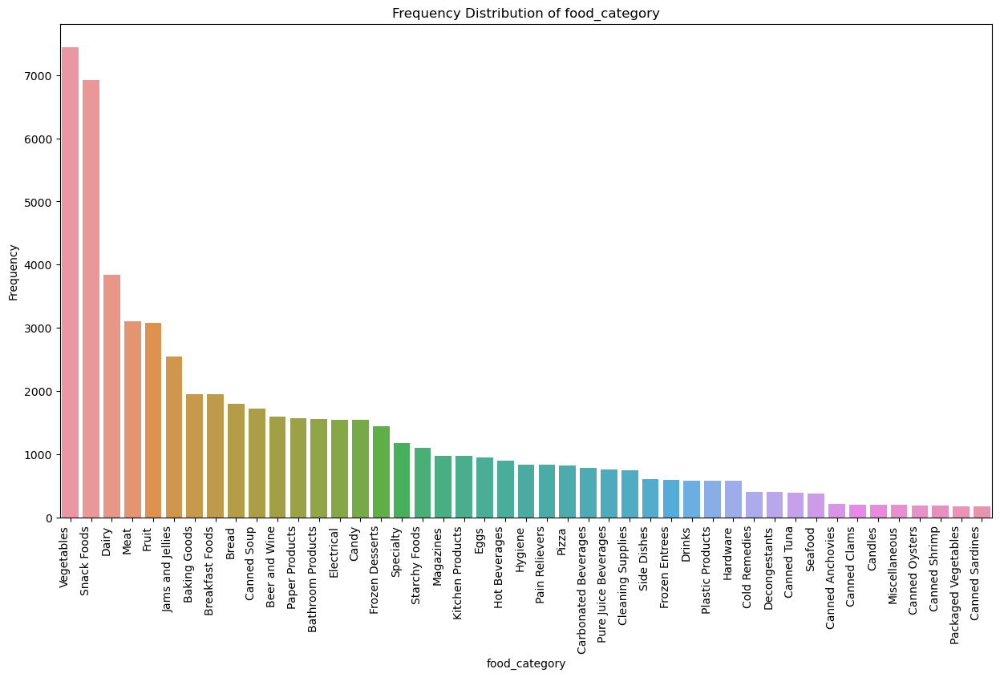

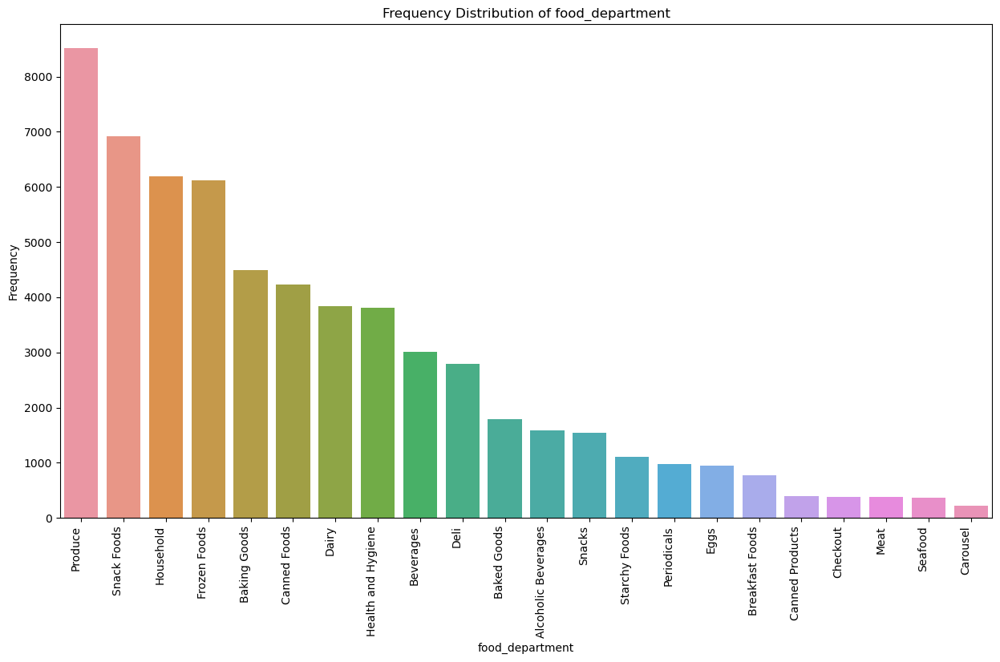

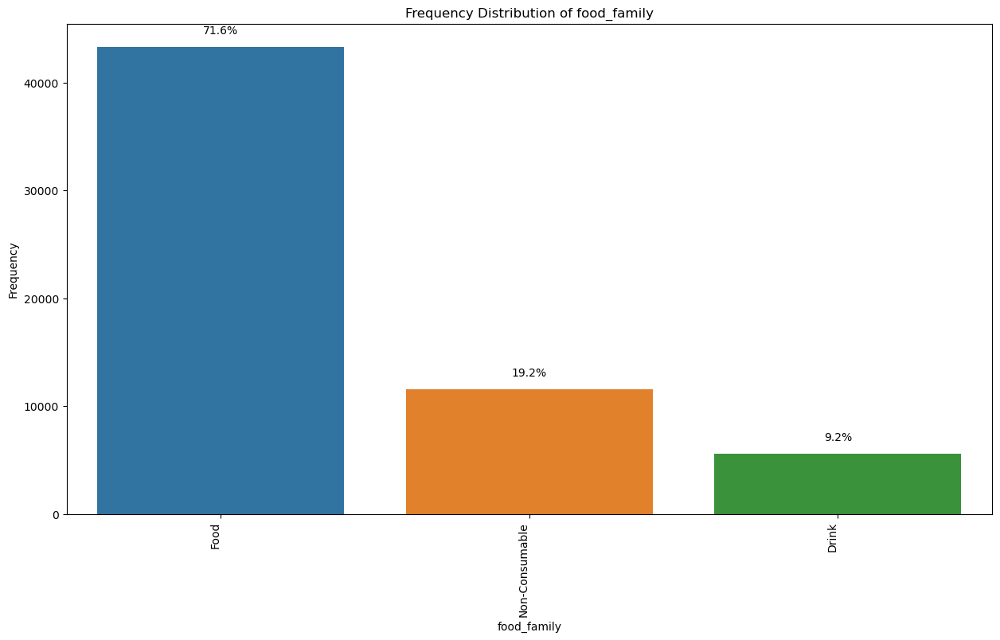

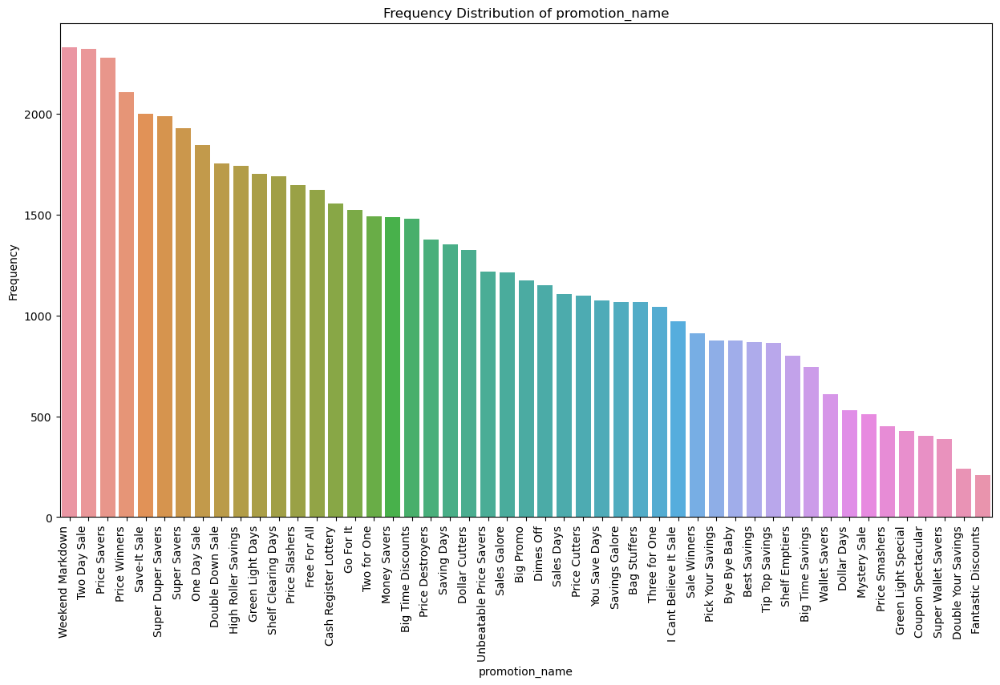

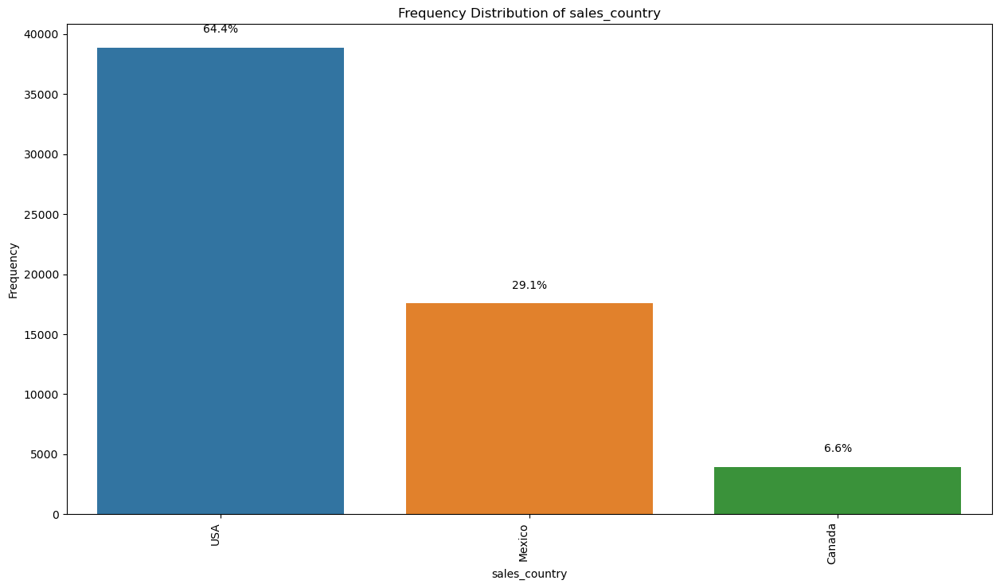

...

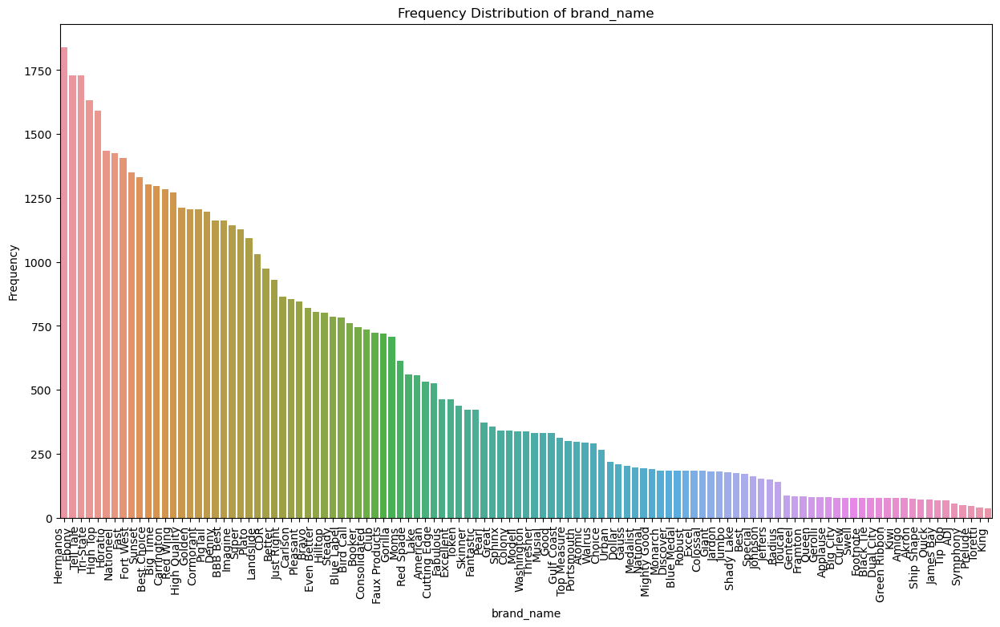

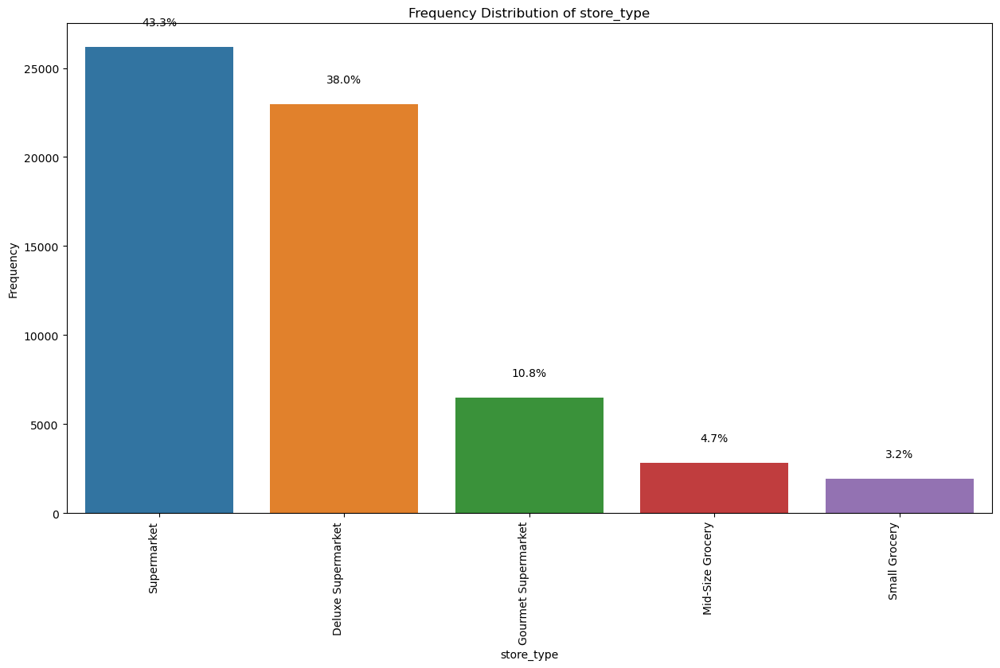

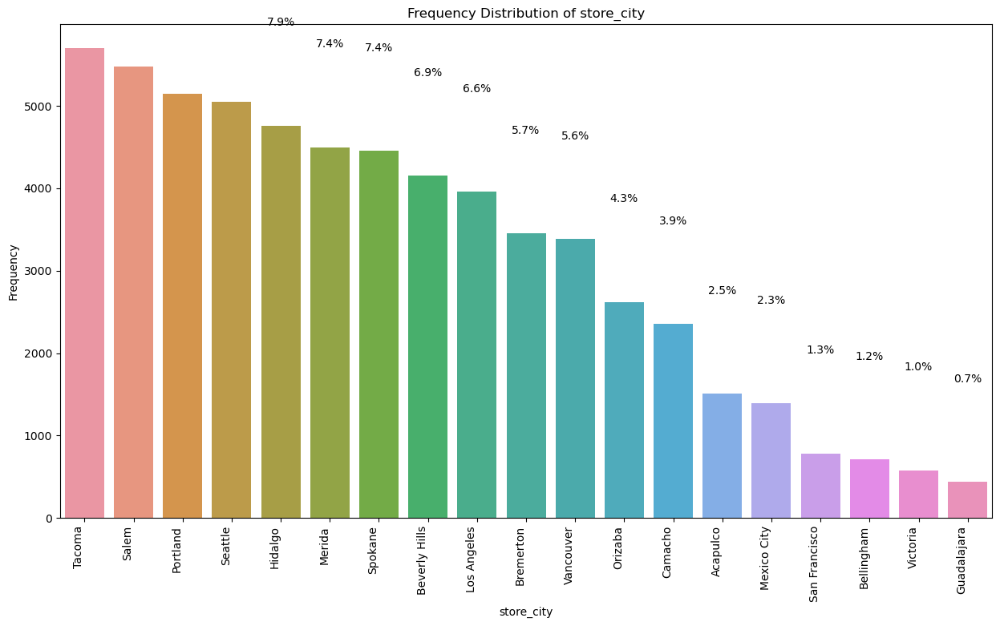

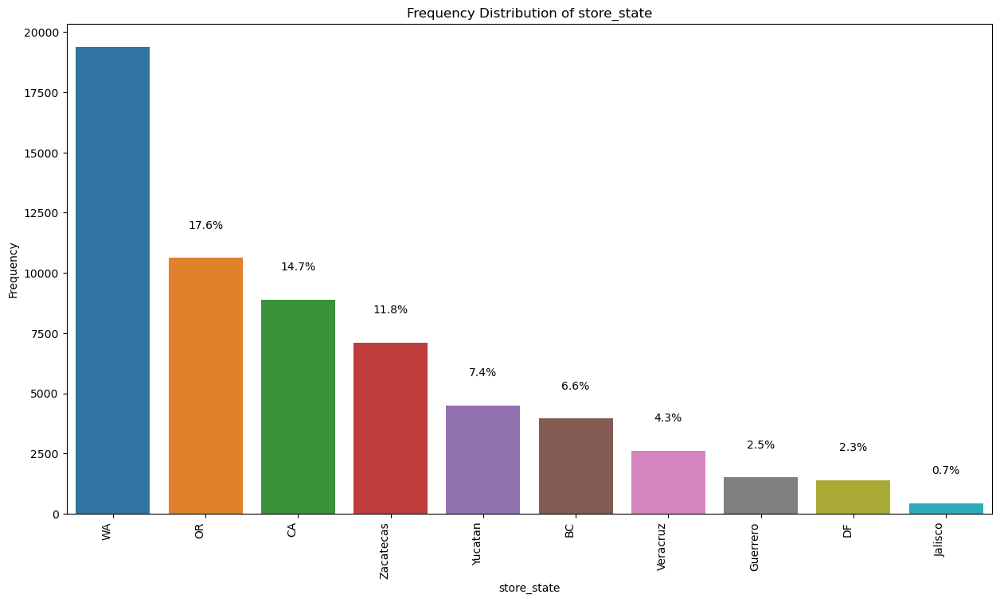

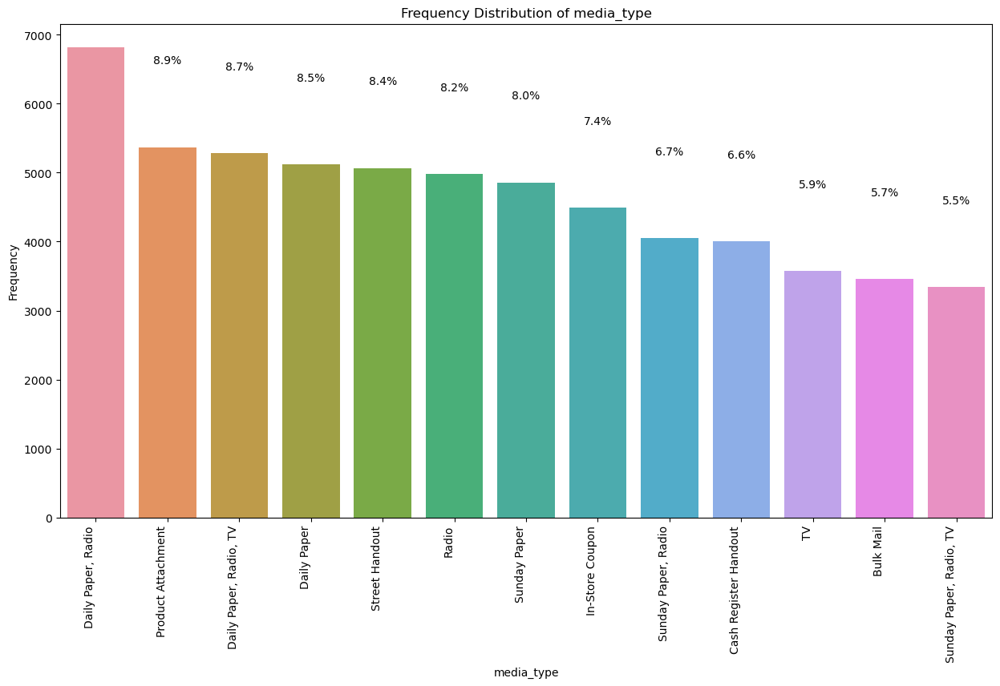

In [169]:
import matplotlib.pyplot as plt
import seaborn as sns

for col in cat_df:
    plt.figure(figsize=(15, 8))  # Adjust the figure size as needed
    
    unique_values = df[col].nunique()
    
    ax = sns.countplot(data=df, x=col, order=df[col].value_counts().index)
    
    # Rotate x-axis labels for better readability
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, horizontalalignment='right')
    
    # Display percentage values on top of the bars only if there are <= 20 unique values
    if unique_values <= 20:
        total = len(df[col])
        for p in ax.patches:
            percentage = '{:.1f}%'.format(100 * p.get_height() / total)
            x = p.get_x() + p.get_width() / 2
            y = p.get_height() + 0.02 * total  # Initial y-position
            
            # Adjust y-position dynamically to avoid collisions
            if y > 0.95 * total:  # If too close to the top, move below the bar
                y = p.get_height() - 0.1 * total
            ax.annotate(percentage, (x, y), ha='center')

    plt.title(f'Frequency Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

In [170]:
con_df = df.select_dtypes(include=float).corr(method='spearman')

In [171]:
df.select_dtypes(include=float)

,store_sales(in millions),store_cost(in millions),unit_sales(in millions),total_children,avg_cars_at home(approx),num_children_at_home,avg_cars_at home(approx).1,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,cost
0,7.36,2.7232,4.0,1.0,1.0,1.0,1.0,1.84,19.70,17.70,1.0,0.0,17.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,126.62
1,5.52,2.5944,3.0,0.0,4.0,0.0,4.0,1.84,19.70,17.70,1.0,0.0,17.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,59.86
2,3.68,1.3616,2.0,4.0,1.0,0.0,1.0,1.84,19.70,17.70,1.0,0.0,17.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,84.16
3,3.68,1.1776,2.0,2.0,2.0,2.0,2.0,1.84,19.70,17.70,1.0,0.0,17.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,95.78
4,4.08,1.4280,3.0,0.0,2.0,0.0,2.0,1.36,7.12,5.11,0.0,1.0,29.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,50.79
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60423,2.76,1.3248,1.0,1.0,1.0,1.0,1.0,2.76,19.60,18.60,1.0,0.0,26.0,22478.0,15321.0,4294.0,2863.0,1.0,0.0,0.0,0.0,0.0,95.25
60424,1.60,0.4960,1.0,2.0,2.0,0.0,2.0,1.60,17.40,15.30,1.0,0.0,36.0,22478.0,15321.0,4294.0,2863.0,1.0,0.0,0.0,0.0,0.0,69.42
60425,5.52,2.5392,2.0,1.0,3.0,0.0,3.0,2.76,19.60,18.60,1.0,0.0,26.0,22478.0,15321.0,4294.0,2863.0,1.0,0.0,0.0,0.0,0.0,67.51
60426,8.28,2.5668,3.0,2.0,4.0,0.0,4.0,2.76,19.60,18.60,1.0,0.0,26.0,34452.0,27463.0,4193.0,2795.0,1.0,0.0,0.0,0.0,1.0,132.88


In [172]:
con_df

,store_sales(in millions),store_cost(in millions),unit_sales(in millions),total_children,avg_cars_at home(approx),num_children_at_home,avg_cars_at home(approx).1,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,cost
store_sales(in millions),1.000000,0.965907,0.471212,0.068749,0.001162,0.017398,0.001162,0.854892,0.040210,0.036380,0.034906,-0.006767,-0.013900,0.014816,0.010338,0.023560,0.023560,-0.029969,0.022754,0.035992,0.035992,0.035524,-0.007317
store_cost(in millions),0.965907,1.000000,0.453527,0.065061,-0.000026,0.014159,-0.000026,0.826602,0.038630,0.034971,0.031866,-0.006341,-0.013680,0.016410,0.012180,0.024113,0.024113,-0.029424,0.022917,0.036924,0.036924,0.035418,-0.007402
unit_sales(in millions),0.471212,0.453527,1.000000,0.153578,0.021092,0.044179,0.021092,-0.002903,0.001000,0.001159,0.001489,-0.001158,-0.000207,0.023368,0.019338,0.030718,0.030718,-0.051337,0.027012,0.046592,0.046592,0.044947,-0.014185
total_children,0.068749,0.065061,0.153578,1.000000,0.097251,0.318106,0.097251,-0.000480,0.000011,0.000300,0.002491,-0.002945,0.002581,0.001863,0.016858,-0.021989,-0.021989,0.002101,0.000135,-0.013507,-0.013507,-0.003276,-0.003614
avg_cars_at home(approx),0.001162,-0.000026,0.021092,0.097251,1.000000,0.118908,1.000000,-0.008785,0.004429,0.004161,0.003741,-0.004359,-0.007109,-0.010751,-0.012216,-0.006784,-0.006784,-0.001970,0.018261,-0.004712,-0.004712,-0.000581,0.009466
num_children_at_home,0.017398,0.014159,0.044179,0.318106,0.118908,1.000000,0.118908,-0.001363,-0.001898,-0.002006,-0.000604,-0.002513,-0.002346,0.009176,0.024721,-0.014627,-0.014627,-0.023242,-0.011456,-0.023869,-0.023869,-0.014185,-0.003305
avg_cars_at home(approx).1,0.001162,-0.000026,0.021092,0.097251,1.000000,0.118908,1.000000,-0.008785,0.004429,0.004161,0.003741,-0.004359,-0.007109,-0.010751,-0.012216,-0.006784,-0.006784,-0.001970,0.018261,-0.004712,-0.004712,-0.000581,0.009466
SRP,0.854892,0.826602,-0.002903,-0.000480,-0.008785,-0.001363,-0.008785,1.000000,0.047582,0.043332,0.044533,-0.006351,-0.015149,0.000663,-0.000556,0.004089,0.004089,0.000326,0.002266,0.002359,0.002359,0.003945,0.001921
gross_weight,0.040210,0.038630,0.001000,0.000011,0.004429,-0.001898,0.004429,0.047582,1.000000,0.988850,0.052735,-0.033997,-0.008691,-0.005163,-0.004234,-0.004027,-0.004027,0.001894,0.002364,0.001887,0.001887,0.003076,0.001530
net_weight,0.036380,0.034971,0.001159,0.000300,0.004161,-0.002006,0.004161,0.043332,0.988850,1.000000,0.055289,-0.034883,-0.012257,-0.004688,-0.003410,-0.003953,-0.003953,0.001746,0.002469,0.002421,0.002421,0.002618,0.001518


<AxesSubplot:>

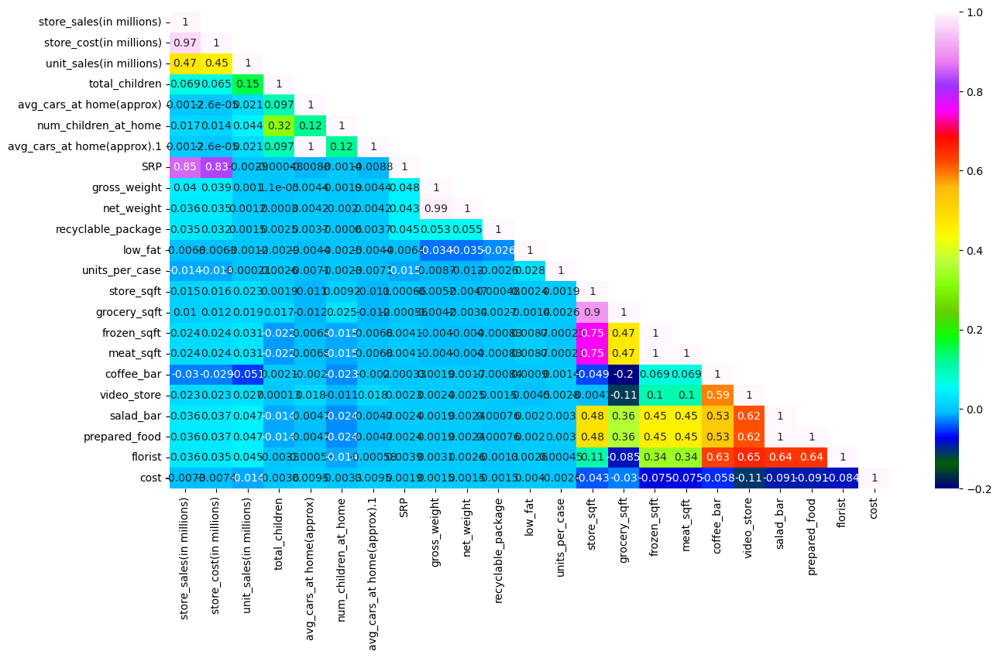

In [173]:
plt.figure(figsize=(15, 8))
sns.heatmap(con_df,annot=True,mask=np.triu(con_df.corr(),k=1),cmap='gist_ncar')

In [174]:
df = df.drop('avg_cars_at home(approx)',axis=1)

In [175]:
df.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type,cost
0,Breakfast Foods,Frozen Foods,Food,7.36,2.7232,4.0,Bag Stuffers,USA,M,F,1.0,Partial High School,Normal,Skilled Manual,Y,$10K - $30K,1.0,1.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,"Daily Paper, Radio",126.62
1,Breakfast Foods,Frozen Foods,Food,5.52,2.5944,3.0,Cash Register Lottery,USA,M,M,0.0,Bachelors Degree,Silver,Professional,Y,$50K - $70K,0.0,4.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,"Daily Paper, Radio",59.86
2,Breakfast Foods,Frozen Foods,Food,3.68,1.3616,2.0,High Roller Savings,USA,S,F,4.0,Partial High School,Normal,Manual,N,$10K - $30K,0.0,1.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,"Daily Paper, Radio",84.16
3,Breakfast Foods,Frozen Foods,Food,3.68,1.1776,2.0,Cash Register Lottery,USA,M,F,2.0,High School Degree,Bronze,Manual,Y,$30K - $50K,2.0,2.0,Carrington,1.84,19.70,17.70,1.0,0.0,17.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,In-Store Coupon,95.78
4,Breakfast Foods,Frozen Foods,Food,4.08,1.4280,3.0,Double Down Sale,USA,M,M,0.0,Partial High School,Bronze,Skilled Manual,N,$30K - $50K,0.0,2.0,Golden,1.36,7.12,5.11,0.0,1.0,29.0,Deluxe Supermarket,Salem,OR,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,Radio,50.79


In [176]:
num_df_to_be_power_transformed = num_df.drop(['total_children','avg_cars_at home(approx)','avg_cars_at home(approx).1','num_children_at_home','recyclable_package', 'low_fat', 'coffee_bar', 'video_store','salad_bar', 'prepared_food', 'florist'],axis=1)

In [177]:
num_df_to_be_power_transformed.head()

,store_sales(in millions),store_cost(in millions),unit_sales(in millions),SRP,gross_weight,net_weight,units_per_case,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,cost
0,7.36,2.7232,4.0,1.84,19.70,17.70,17.0,27694.0,18670.0,5415.0,3610.0,126.62
1,5.52,2.5944,3.0,1.84,19.70,17.70,17.0,27694.0,18670.0,5415.0,3610.0,59.86
2,3.68,1.3616,2.0,1.84,19.70,17.70,17.0,27694.0,18670.0,5415.0,3610.0,84.16
3,3.68,1.1776,2.0,1.84,19.70,17.70,17.0,27694.0,18670.0,5415.0,3610.0,95.78
4,4.08,1.4280,3.0,1.36,7.12,5.11,29.0,27694.0,18670.0,5415.0,3610.0,50.79



Skewness of store_sales(in millions): 0.6783827681466109


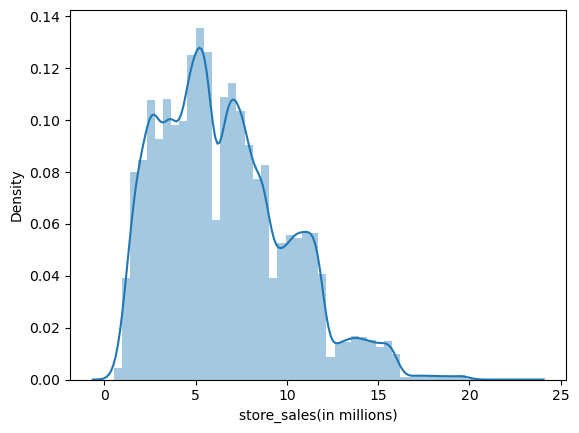


Skewness of store_cost(in millions): 0.8329204965976573


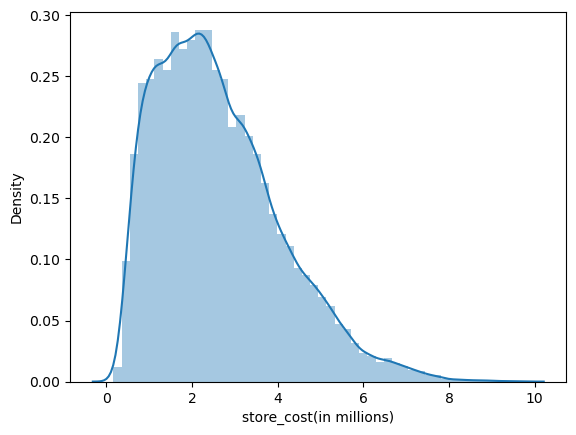


Skewness of unit_sales(in millions): 0.05250417484542241


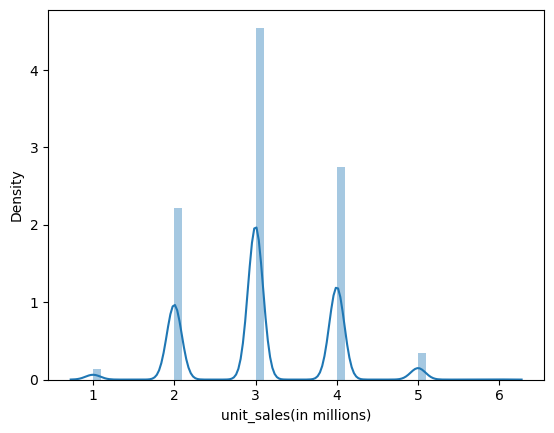


Skewness of SRP: 0.1379245500590523


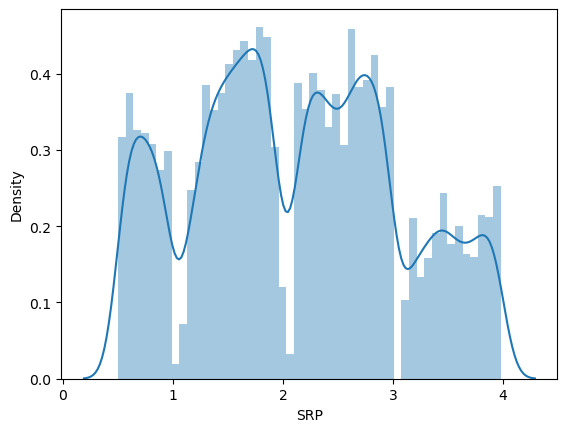


Skewness of gross_weight: 0.09297548277839975


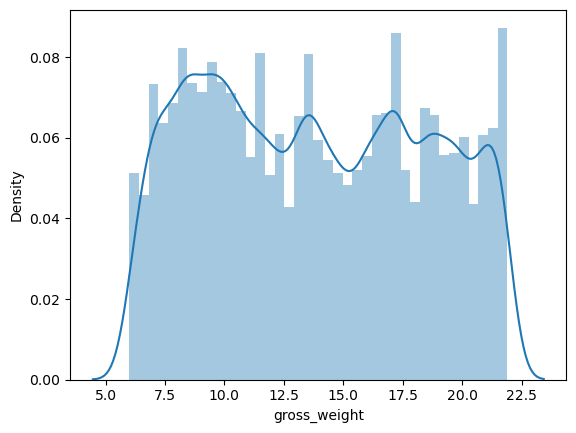


Skewness of net_weight: 0.10667760086268013


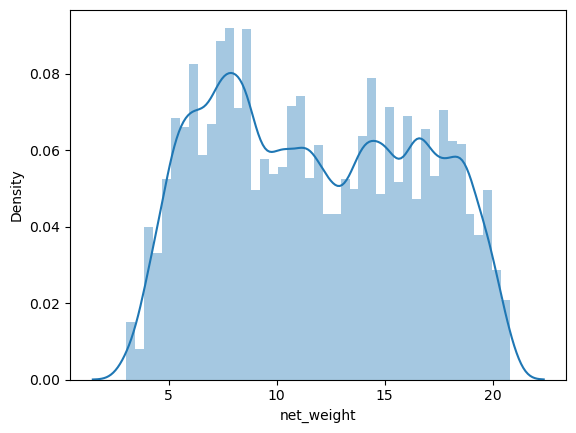


Skewness of units_per_case: -0.08362695217487709


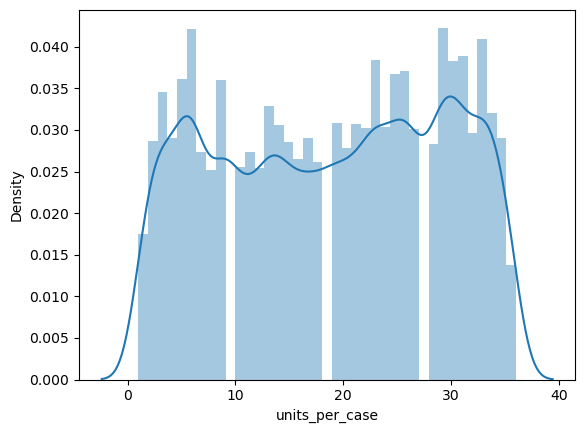


Skewness of store_sqft: 0.38667853710894284


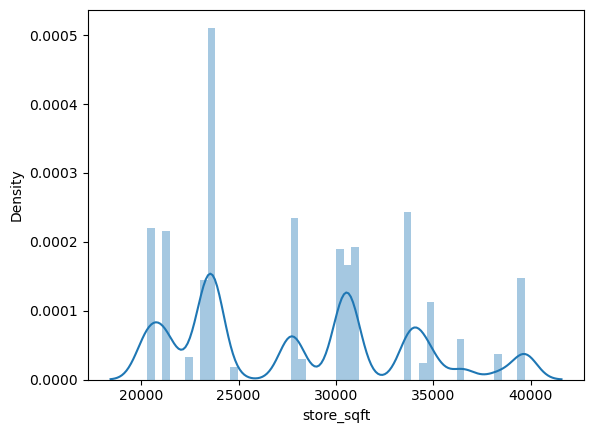


Skewness of grocery_sqft: 0.38531390273232674


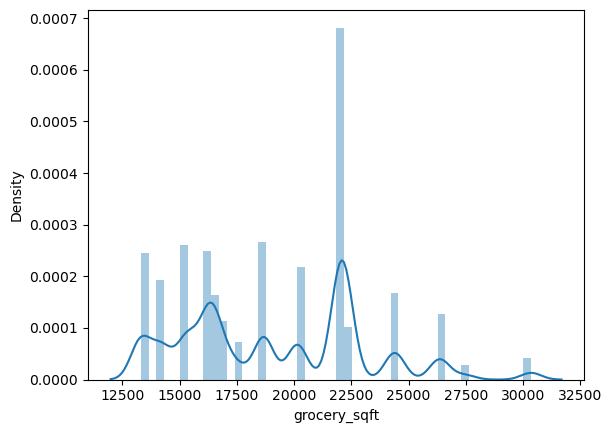


Skewness of frozen_sqft: 0.5610409561170902


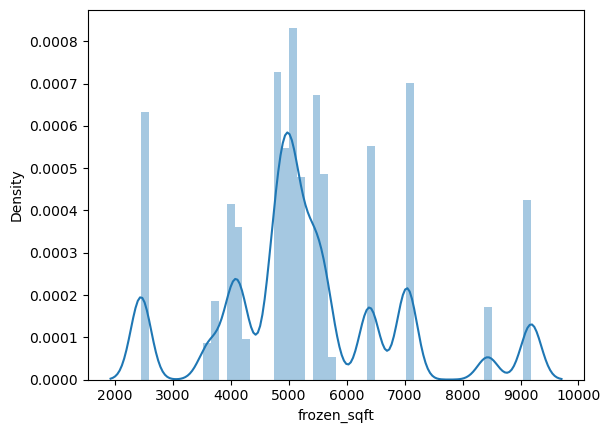


Skewness of meat_sqft: 0.5612377606491394


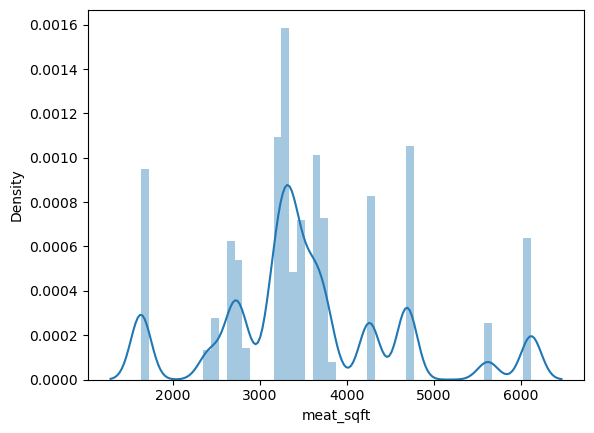


Skewness of cost: 0.037238950837956246


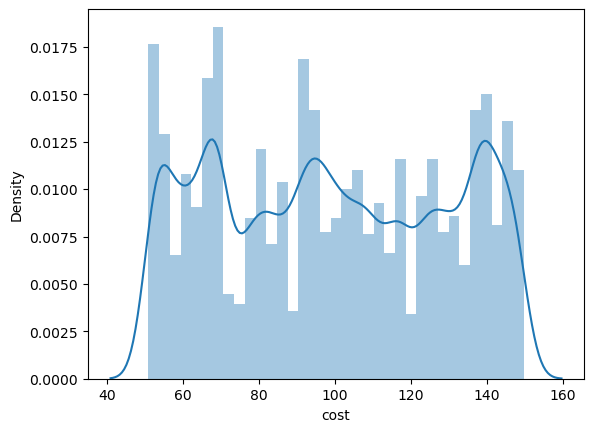

In [178]:
for i in num_df_to_be_power_transformed.columns:
        sns.distplot(num_df[i])
        print(f'\nSkewness of {i}:',num_df[i].skew())
        plt.show()

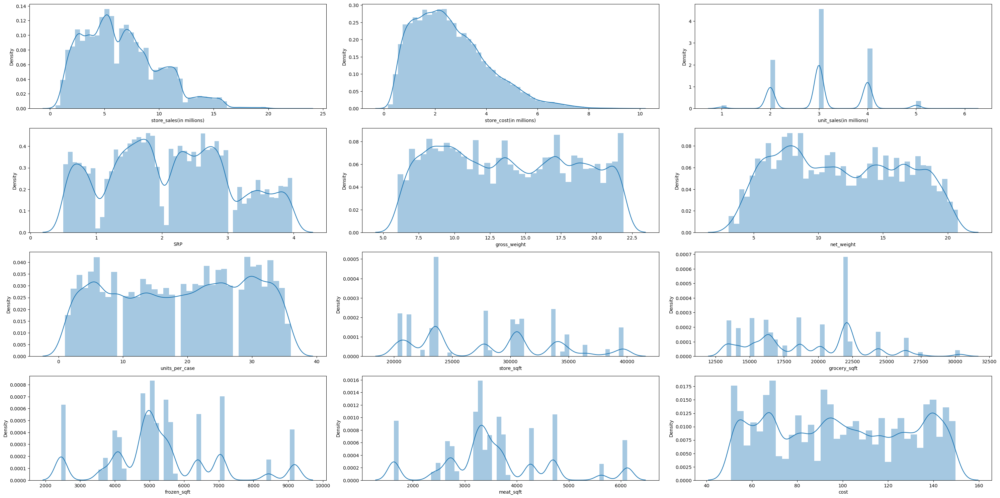

In [179]:
cols=list(num_df_to_be_power_transformed.columns)

fig, ax= plt.subplots(4,3, figsize=(30,15))

for i, subplot in zip(cols, ax.flatten()):
    sns.distplot(num_df_to_be_power_transformed[i], ax=subplot,kde=True)
    
plt.tight_layout()
plt.show()

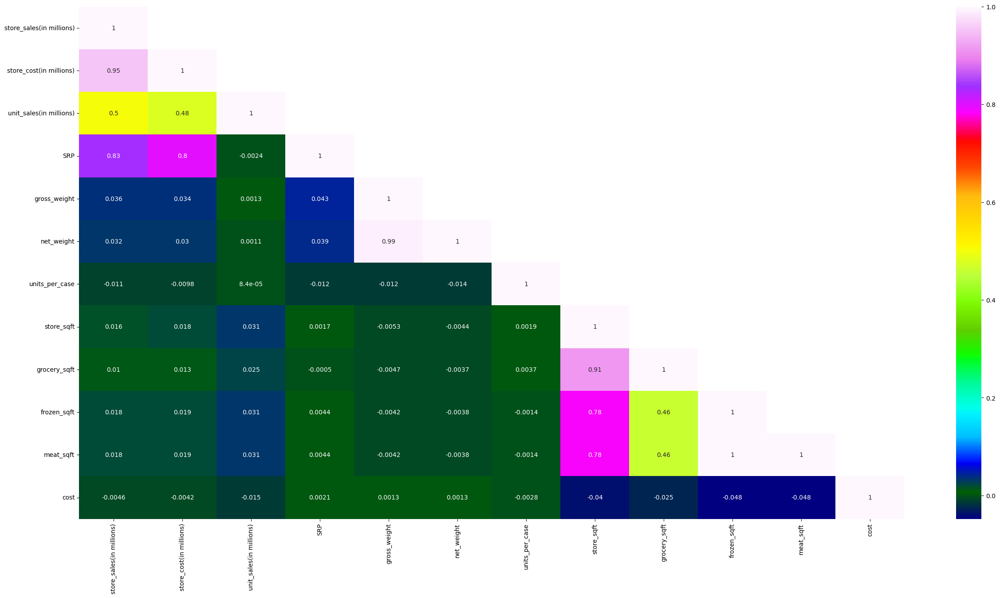

In [180]:
plt.figure(figsize=(30,15))
sns.heatmap(num_df_to_be_power_transformed.corr(),annot=True,mask=np.triu(num_df_to_be_power_transformed.corr(),k=1),cmap='gist_ncar')
plt.show()

In [181]:
px.scatter(data_frame=df, x="store_sales(in millions)", y="SRP",color='store_cost(in millions)',trendline="ols",marginal_y="box", marginal_x="box")

In [182]:
px.scatter(data_frame=df, x="store_sales(in millions)", y="store_cost(in millions)",color='store_sqft',trendline="ols",marginal_y="box", marginal_x="box")

# ENCODING THE DATA

In [183]:
cat_df.nunique()

food_category          45
food_department        22
food_family             3
promotion_name         49
sales_country           3
marital_status          2
gender                  2
education               5
member_card             4
occupation              5
houseowner              2
avg. yearly_income      8
brand_name            111
store_type              5
store_city             19
store_state            10
media_type             13
dtype: int64

W.r.t frequency of entries, encoded the categorical data

In [184]:
#label encoding for martial status,gender and houseowner
label_encoder = LabelEncoder()
df['marital_status'] = label_encoder.fit_transform(df['marital_status'])
df['gender'] = label_encoder.fit_transform(df['gender'])
df['houseowner'] = label_encoder.fit_transform(df['houseowner'])



# Ordinal encoding for 'sales_country'
df['sales_country'] = df['sales_country'].replace('USA',2).replace('Mexico',1).replace('Canada',0)

# Ordinal encoding for 'member_card'
member_card_order = {'Golden': 1, 'Silver': 0, 'Bronze': 3, 'Normal': 2}
df['member_card'] = df['member_card'].map(member_card_order)

# Ordinal encoding for 'education'
education_order = {'Partial High School': 4, 'Bachelors Degree': 2, 'High School Degree': 3,
                       'Graduate Degree': 0, 'Partial College': 1}
df['education'] = df['education'].map(education_order)
# Ordinal encoding for 'store_type'
store_type_order = {'Deluxe Supermarket': 3, 'Supermarket': 4, 'Gourmet Supermarket': 2,
                        'Small Grocery': 0, 'Mid-Size Grocery': 1}
df['store_type'] = df['store_type'].map(store_type_order)
    
    
# Ordinal encoding for 'avg. yearly_income'
income_order = {
        '$10K - $30K': 6,
        '$30K - $50K': 7,
        '$50K - $70K': 5,
        '$70K - $90K': 3,
        '$90K - $110K': 2,
        '$110K - $130K': 4,
        '$130K - $150K': 1,
        '$150K +': 0
}

df['avg. yearly_income'] = df['avg. yearly_income'].map(income_order)


In [185]:
 multiple_values_columns = ['occupation','food_category','food_department','promotion_name','brand_name','store_city','store_state','media_type']

for col in multiple_values_columns:
        melt_with_cost = pd.melt(df,id_vars=col,value_vars='cost',value_name='cost')
        mean_cost = np.ceil(melt_with_cost.groupby(by=col)['cost'].mean()).to_dict()
        df[col] = df[col].map(mean_cost)
    


In [186]:
df.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type,cost
0,100.0,100.0,Food,7.36,2.7232,4.0,107.0,2,0,0,1.0,4,2,100.0,1,6,1.0,1.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,98.0,126.62
1,100.0,100.0,Food,5.52,2.5944,3.0,75.0,2,0,1,0.0,2,0,99.0,1,5,0.0,4.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,98.0,59.86
2,100.0,100.0,Food,3.68,1.3616,2.0,96.0,2,1,0,4.0,4,2,99.0,0,6,0.0,1.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,98.0,84.16
3,100.0,100.0,Food,3.68,1.1776,2.0,75.0,2,0,0,2.0,3,3,99.0,1,7,2.0,2.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,100.0,95.78
4,100.0,100.0,Food,4.08,1.4280,3.0,81.0,2,0,1,0.0,4,3,100.0,0,7,0.0,2.0,101.0,1.36,7.12,5.11,0.0,1.0,29.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,97.0,50.79


In [187]:
df['food_family'].value_counts()

Food              43284
Non-Consumable    11573
Drink              5571
Name: food_family, dtype: int64

In [188]:
#Ordinal Encoding for food family column

In [191]:
df['food_family'] = df['food_family'].replace('Food',2).replace('Non-Consumable',1).replace('Drink',0)

In [192]:
df['food_family'].value_counts()

2    43284
1    11573
0     5571
Name: food_family, dtype: int64

In [197]:
X = df.drop(columns='cost')
y = df['cost']

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=.20,random_state=1)

In [198]:
X_train.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type
19714,100.0,100.0,2,3.90,1.6380,3.0,113.0,0,0,0,0.0,1,0,100.0,1,3,0.0,2.0,100.0,1.30,11.80,8.80,0.0,1.0,27.0,3,102.0,102.0,23112.0,16418.0,4016.0,2678.0,1.0,1.0,1.0,1.0,1.0,109.0
54187,100.0,100.0,2,4.98,1.6932,3.0,87.0,2,1,1,2.0,4,2,100.0,0,6,0.0,1.0,100.0,1.66,9.84,7.84,1.0,1.0,32.0,4,99.0,100.0,39696.0,24390.0,9184.0,6122.0,0.0,0.0,1.0,1.0,0.0,115.0
10944,99.0,99.0,2,9.87,4.7376,3.0,122.0,2,0,0,4.0,2,3,99.0,0,5,2.0,3.0,100.0,3.29,8.86,6.85,1.0,1.0,5.0,2,102.0,102.0,23688.0,15337.0,5011.0,3340.0,1.0,1.0,1.0,1.0,1.0,105.0
55153,100.0,100.0,2,9.24,2.8644,4.0,96.0,2,1,1,2.0,4,0,100.0,1,1,0.0,1.0,100.0,2.31,7.04,5.03,0.0,0.0,3.0,2,102.0,102.0,23688.0,15337.0,5011.0,3340.0,1.0,1.0,1.0,1.0,1.0,91.0
33218,102.0,101.0,2,8.65,3.9790,5.0,107.0,1,1,0,5.0,4,2,99.0,0,6,0.0,2.0,101.0,1.73,12.80,10.80,0.0,1.0,23.0,4,98.0,98.0,23593.0,17475.0,3671.0,2447.0,0.0,0.0,0.0,0.0,0.0,106.0


In [199]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 48342 entries, 19714 to 33003
Data columns (total 38 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   food_category               48342 non-null  float64
 1   food_department             48342 non-null  float64
 2   food_family                 48342 non-null  int64  
 3   store_sales(in millions)    48342 non-null  float64
 4   store_cost(in millions)     48342 non-null  float64
 5   unit_sales(in millions)     48342 non-null  float64
 6   promotion_name              48342 non-null  float64
 7   sales_country               48342 non-null  int64  
 8   marital_status              48342 non-null  int32  
 9   gender                      48342 non-null  int32  
 10  total_children              48342 non-null  float64
 11  education                   48342 non-null  int64  
 12  member_card                 48342 non-null  int64  
 13  occupation                 

In [220]:
transform_cols = num_df_to_be_power_transformed.columns.to_list()

In [221]:
transform_cols

['store_sales(in millions)',
 'store_cost(in millions)',
 'unit_sales(in millions)',
 'SRP',
 'gross_weight',
 'net_weight',
 'units_per_case',
 'store_sqft',
 'grocery_sqft',
 'frozen_sqft',
 'meat_sqft',
 'cost']

In [206]:
pt = PowerTransformer()
X_train['store_sales(in millions)'] = pt.fit_transform(X_train[['store_sales(in millions)']])

In [207]:
X_train['store_cost(in millions)'] = pt.fit_transform(X_train[['store_cost(in millions)']])

In [208]:
X_train['unit_sales(in millions)'] = pt.fit_transform(X_train[['unit_sales(in millions)']])

In [209]:
X_train['SRP'] = pt.fit_transform(X_train[['SRP']])

In [210]:
X_train['gross_weight'] = pt.fit_transform(X_train[['gross_weight']])

In [211]:
X_train['net_weight'] = pt.fit_transform(X_train[['net_weight']])

In [212]:
X_train['units_per_case'] = pt.fit_transform(X_train[['units_per_case']])

In [213]:
X_train['store_sqft'] = pt.fit_transform(X_train[['store_sqft']])

In [214]:
X_train['grocery_sqft'] = pt.fit_transform(X_train[['grocery_sqft']])

In [215]:
X_train['frozen_sqft'] = pt.fit_transform(X_train[['frozen_sqft']])

In [216]:
X_train['meat_sqft'] = pt.fit_transform(X_train[['meat_sqft']])

In [222]:
num_df_to_be_power_transformed = num_df_to_be_power_transformed.drop('cost',axis=1)

In [223]:
num_df_to_be_power_transformed.columns

Index(['store_sales(in millions)', 'store_cost(in millions)',
       'unit_sales(in millions)', 'SRP', 'gross_weight', 'net_weight',
       'units_per_case', 'store_sqft', 'grocery_sqft', 'frozen_sqft',
       'meat_sqft'],
      dtype='object')

In [225]:
for i in num_df_to_be_power_transformed.columns:
    X_test[i] = pt.transform(X_test[[i]])

In [226]:
X_train.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type
19714,100.0,100.0,2,-0.708008,-0.601154,-0.097845,113.0,0,0,0,0.0,1,0,100.0,1,3,0.0,2.0,100.0,-0.856457,-0.397192,-0.605553,0.0,1.0,0.774438,3,102.0,102.0,0.0,0.0,-0.798691,-0.798018,1.0,1.0,1.0,1.0,1.0,109.0
54187,100.0,100.0,2,-0.324885,-0.550408,-0.097845,87.0,2,1,1,2.0,4,2,100.0,0,6,0.0,1.0,100.0,-0.452260,-0.841627,-0.823600,1.0,1.0,1.306323,4,99.0,100.0,0.0,0.0,2.170013,2.169652,0.0,0.0,1.0,1.0,0.0,115.0
10944,99.0,99.0,2,0.991947,1.359989,-0.097845,122.0,2,0,0,4.0,2,3,99.0,0,5,2.0,3.0,100.0,1.235050,-1.073281,-1.056054,1.0,1.0,-1.321263,2,102.0,102.0,0.0,0.0,-0.110670,-0.111242,1.0,1.0,1.0,1.0,1.0,105.0
55153,100.0,100.0,2,0.848257,0.347795,1.089320,96.0,2,1,1,2.0,4,0,100.0,1,1,0.0,1.0,100.0,0.243990,-1.526172,-1.510260,0.0,0.0,-1.516780,2,102.0,102.0,0.0,0.0,-0.110670,-0.111242,1.0,1.0,1.0,1.0,1.0,91.0
33218,102.0,101.0,2,0.708181,0.993541,2.241775,107.0,1,1,0,5.0,4,2,99.0,0,6,0.0,2.0,101.0,-0.375495,-0.177789,-0.168526,0.0,1.0,0.362093,4,98.0,98.0,0.0,0.0,-1.058253,-1.058771,0.0,0.0,0.0,0.0,0.0,106.0


In [267]:
df.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type,cost
0,100.0,100.0,2,7.36,2.7232,4.0,107.0,2,0,0,1.0,4,2,100.0,1,6,1.0,1.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,98.0,126.62
1,100.0,100.0,2,5.52,2.5944,3.0,75.0,2,0,1,0.0,2,0,99.0,1,5,0.0,4.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,98.0,59.86
2,100.0,100.0,2,3.68,1.3616,2.0,96.0,2,1,0,4.0,4,2,99.0,0,6,0.0,1.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,98.0,84.16
3,100.0,100.0,2,3.68,1.1776,2.0,75.0,2,0,0,2.0,3,3,99.0,1,7,2.0,2.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,100.0,95.78
4,100.0,100.0,2,4.08,1.4280,3.0,81.0,2,0,1,0.0,4,3,100.0,0,7,0.0,2.0,101.0,1.36,7.12,5.11,0.0,1.0,29.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,97.0,50.79


In [227]:
X_test.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type
54312,100.0,99.0,1,10.590363,3.807529,4.006479,81.0,2,0,0,3.0,4,2,99.0,1,6,3.0,1.0,99.0,2.643016,18.467698,16.357036,0.0,0.0,18.065635,3,85.0,95.0,28142.164445,18959.136960,5487.052150,3655.461935,1.0,1.0,1.0,1.0,1.0,97.0
2358,100.0,99.0,2,5.832110,2.913642,3.003858,106.0,2,1,0,5.0,3,3,100.0,0,7,0.0,3.0,98.0,1.941562,13.041206,10.027996,1.0,0.0,3.003858,3,85.0,95.0,28142.164445,18959.136960,5487.052150,3655.461935,1.0,1.0,1.0,1.0,1.0,105.0
8340,99.0,99.0,2,2.562837,0.947224,4.006479,96.0,1,1,0,3.0,2,3,99.0,0,5,0.0,2.0,100.0,0.639710,8.672497,6.654940,0.0,1.0,34.157266,2,107.0,105.0,24137.056399,17101.799641,4202.264151,2799.539970,1.0,0.0,1.0,1.0,1.0,105.0
3714,100.0,99.0,2,7.819202,2.733221,3.003858,95.0,2,0,1,3.0,4,2,100.0,1,6,0.0,1.0,99.0,2.602926,8.120350,6.113058,1.0,0.0,32.144954,4,102.0,102.0,23973.211289,14423.224113,5708.343941,3802.547728,0.0,0.0,0.0,0.0,1.0,91.0
31868,102.0,101.0,2,8.481749,2.710368,3.003858,81.0,2,1,0,3.0,4,1,100.0,0,6,0.0,1.0,98.0,2.823429,20.277155,19.271866,1.0,1.0,9.023893,3,99.0,100.0,34417.932748,22472.238024,7137.940854,4755.279059,1.0,0.0,1.0,1.0,1.0,86.0



Skewness of store_sales(in millions): 0.01124510439163322


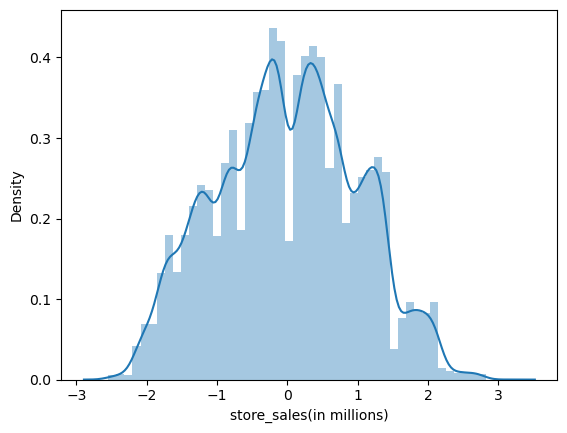


Skewness of store_cost(in millions): 0.01334669774436978


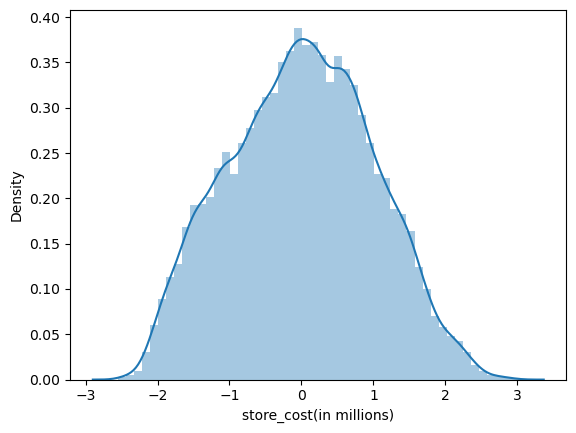


Skewness of unit_sales(in millions): -0.0212995464774317


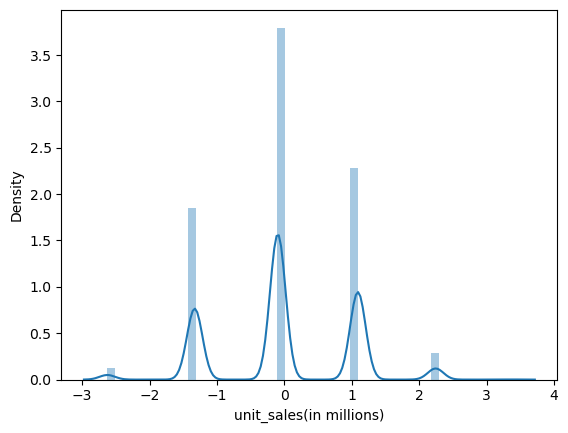


Skewness of SRP: 0.003370728248891775


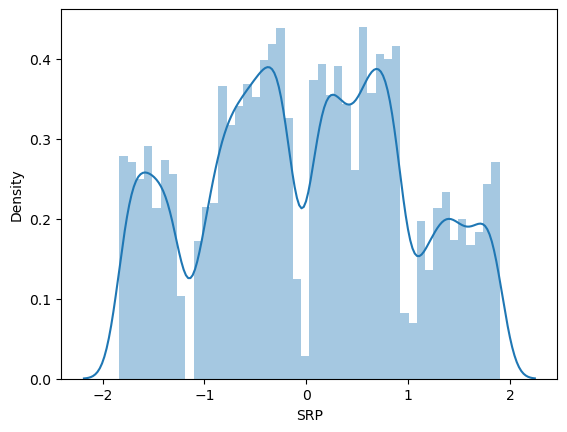


Skewness of gross_weight: -0.005308863280451478


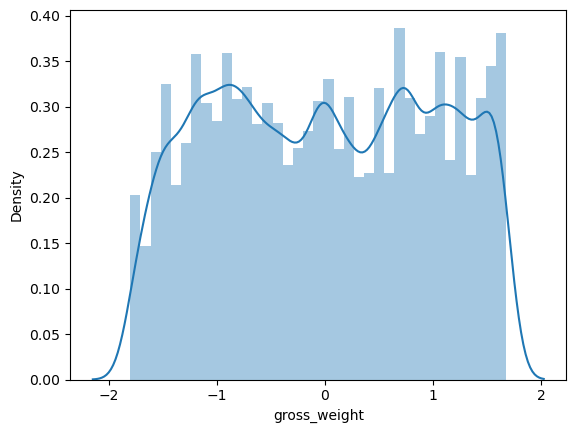


Skewness of net_weight: -0.009422320817374121


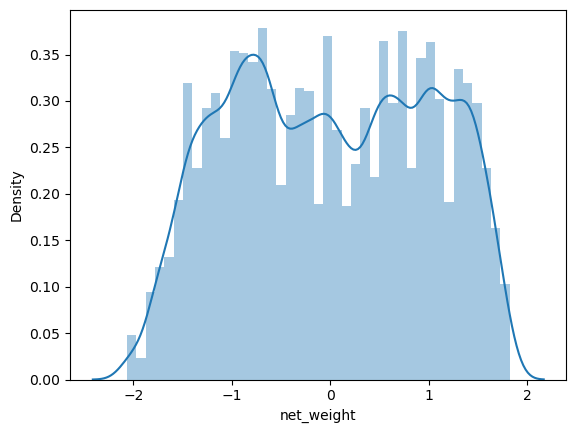


Skewness of units_per_case: -0.00916689074523021


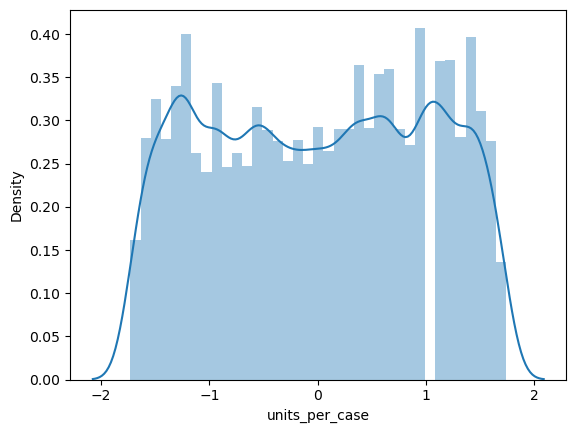


Skewness of store_sqft: 0


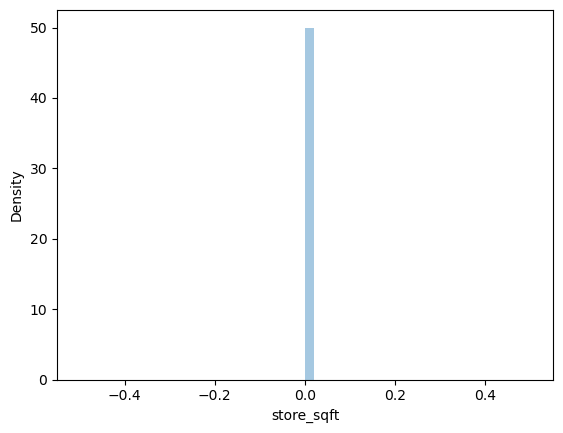


Skewness of grocery_sqft: 0


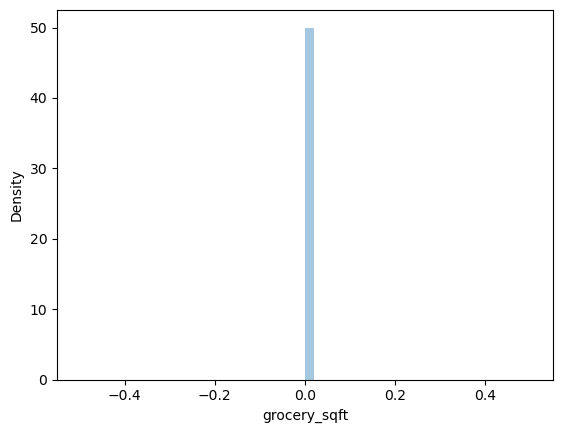


Skewness of frozen_sqft: -0.020094129222187465


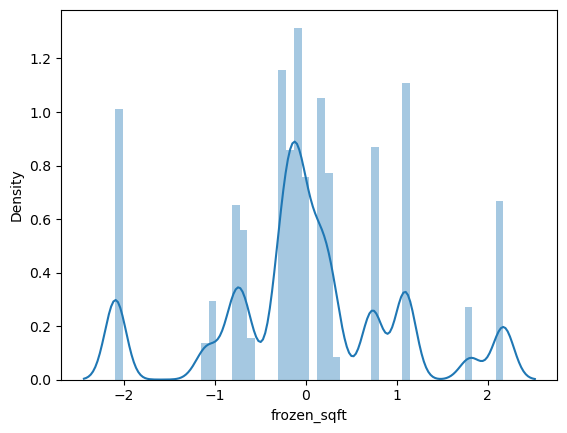


Skewness of meat_sqft: -0.020186067612624002


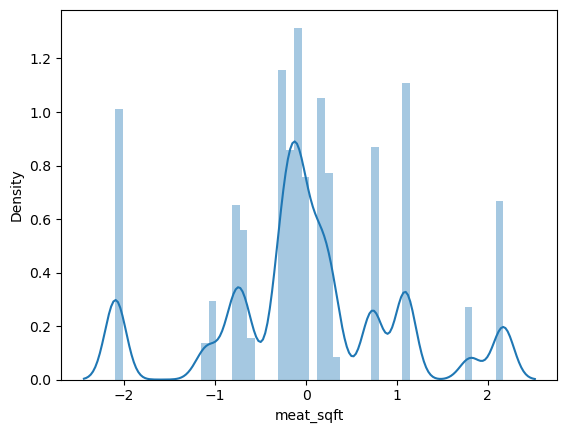

In [229]:
for i in num_df_to_be_power_transformed.columns:
        sns.distplot(X_train[i])
        print(f'\nSkewness of {i}:',X_train[i].skew())
        plt.show()

In [231]:
for i in num_df_to_be_power_transformed.columns:
    print('skewness of',i,':',df[i].skew())

skewness of store_sales(in millions) : 0.6783827681466109
skewness of store_cost(in millions) : 0.8329204965976573
skewness of unit_sales(in millions) : 0.05250417484542241
skewness of SRP : 0.1379245500590523
skewness of gross_weight : 0.09297548277839975
skewness of net_weight : 0.10667760086268013
skewness of units_per_case : -0.08362695217487709
skewness of store_sqft : 0.38667853710894284
skewness of grocery_sqft : 0.38531390273232674
skewness of frozen_sqft : 0.5610409561170902
skewness of meat_sqft : 0.5612377606491394


In [233]:
for i in num_df_to_be_power_transformed.columns:
    print('skewness of',i,':',X_train[i].skew())

skewness of store_sales(in millions) : 0.01124510439163322
skewness of store_cost(in millions) : 0.01334669774436978
skewness of unit_sales(in millions) : -0.0212995464774317
skewness of SRP : 0.003370728248891775
skewness of gross_weight : -0.005308863280451478
skewness of net_weight : -0.009422320817374121
skewness of units_per_case : -0.00916689074523021
skewness of store_sqft : 0
skewness of grocery_sqft : 0
skewness of frozen_sqft : -0.020094129222187465
skewness of meat_sqft : -0.020186067612624002


In [234]:
#After applying powertransformation we can see that skewness has decreased and the distribution has become more near normal

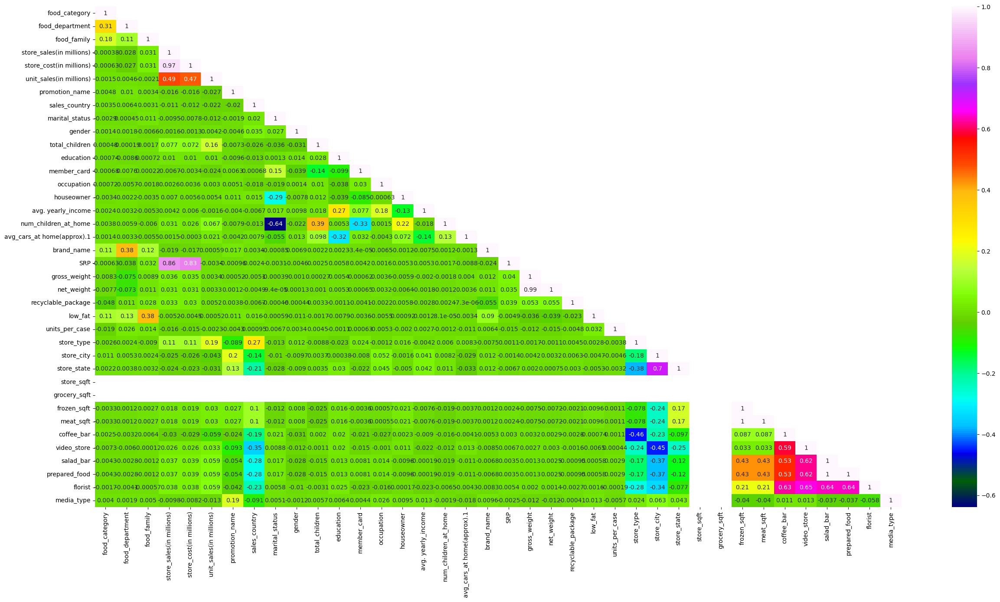

In [236]:
plt.figure(figsize=(30,15))
sns.heatmap(X_train.corr(),annot=True,mask=np.triu(X_train.corr(),k=1),cmap='gist_ncar')
plt.show()

Anything closer to +- 1 indicates high correlation between those two predictor variables.

As we can see from above, there is multicolinearity in the data.

To get a clearer view of correlation visually we use masking. Masks are an array of boolean values for which a condition is met.

SRP is highly correlated with Store_sales and store_cost

Coffee_bar is highly correlated with salad_bar,prepared_food

video_store is highly correlated with salad_bar,prepared_food,florist

Net weight and gross weight are highly correlated

In [238]:
import statsmodels.api as sma
df_constant = sma.add_constant(X_train)
df_constant.head()

,const,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type
19714,1.0,100.0,100.0,2,-0.708008,-0.601154,-0.097845,113.0,0,0,0,0.0,1,0,100.0,1,3,0.0,2.0,100.0,-0.856457,-0.397192,-0.605553,0.0,1.0,0.774438,3,102.0,102.0,0.0,0.0,-0.798691,-0.798018,1.0,1.0,1.0,1.0,1.0,109.0
54187,1.0,100.0,100.0,2,-0.324885,-0.550408,-0.097845,87.0,2,1,1,2.0,4,2,100.0,0,6,0.0,1.0,100.0,-0.452260,-0.841627,-0.823600,1.0,1.0,1.306323,4,99.0,100.0,0.0,0.0,2.170013,2.169652,0.0,0.0,1.0,1.0,0.0,115.0
10944,1.0,99.0,99.0,2,0.991947,1.359989,-0.097845,122.0,2,0,0,4.0,2,3,99.0,0,5,2.0,3.0,100.0,1.235050,-1.073281,-1.056054,1.0,1.0,-1.321263,2,102.0,102.0,0.0,0.0,-0.110670,-0.111242,1.0,1.0,1.0,1.0,1.0,105.0
55153,1.0,100.0,100.0,2,0.848257,0.347795,1.089320,96.0,2,1,1,2.0,4,0,100.0,1,1,0.0,1.0,100.0,0.243990,-1.526172,-1.510260,0.0,0.0,-1.516780,2,102.0,102.0,0.0,0.0,-0.110670,-0.111242,1.0,1.0,1.0,1.0,1.0,91.0
33218,1.0,102.0,101.0,2,0.708181,0.993541,2.241775,107.0,1,1,0,5.0,4,2,99.0,0,6,0.0,2.0,101.0,-0.375495,-0.177789,-0.168526,0.0,1.0,0.362093,4,98.0,98.0,0.0,0.0,-1.058253,-1.058771,0.0,0.0,0.0,0.0,0.0,106.0


# OLS

In [239]:
model=sma.OLS(y_train,df_constant)
result=model.fit()
print(result.summary())

                            OLS Regression Results                            
Dep. Variable:                   cost   R-squared:                       0.316
Model:                            OLS   Adj. R-squared:                  0.316
Method:                 Least Squares   F-statistic:                     638.5
Date:                Tue, 31 Oct 2023   Prob (F-statistic):               0.00
Time:                        14:57:21   Log-Likelihood:            -2.2389e+05
No. Observations:               48342   AIC:                         4.479e+05
Df Residuals:                   48306   BIC:                         4.482e+05
Df Model:                          35                                         
Covariance Type:            nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const               

The Durbin-Watson test is used to check the autocorrelation between the residuals. between 2 and 4: negative autocorrelation

The Jarque-Bera test is used to check the normality of the residuals. the p-value of the test is less than 0.05; that implies the residuals are not normally distributed.

The 'Cond. No' (5.84e+15) represents the Condition Number (CN) which is used to check the multicollinearity If CN > 1000: severe multicollinearity

Thus, it can be seen that there is severe multicollinearity in the data

The results above show some of the attributes with P value higher than the preferred alpha(5%) and thereby showing low statistically significant relationship with the probability of cost. Backward elemination approach is used here to remove those attributes with highest Pvalue one at a time follwed by running the regression repeatedly until all attributes have P Values less than 0.05

In [244]:
insignificant_variables=result.pvalues[result.pvalues>0.05].index
insignificant_variables

Index(['food_department', 'food_family', 'store_sales(in millions)',
       'store_cost(in millions)', 'unit_sales(in millions)', 'marital_status',
       'total_children', 'houseowner', 'avg. yearly_income',
       'num_children_at_home', 'SRP', 'gross_weight', 'net_weight',
       'recyclable_package', 'low_fat', 'units_per_case', 'store_type',
       'video_store', 'florist'],
      dtype='object')

In [245]:
X_train_significant = X_train.drop(['food_department', 'food_family', 'store_sales(in millions)',
       'store_cost(in millions)', 'unit_sales(in millions)', 'marital_status',
       'total_children', 'houseowner', 'avg. yearly_income',
       'num_children_at_home', 'SRP', 'gross_weight', 'net_weight',
       'recyclable_package', 'low_fat', 'units_per_case', 'store_type',
       'video_store', 'florist'],axis=1)                              

In [248]:
df_constant1 = sma.add_constant(X_train_significant)
df_constant1.head()

,const,food_category,promotion_name,sales_country,gender,education,member_card,occupation,avg_cars_at home(approx).1,brand_name,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,salad_bar,prepared_food,media_type
19714,1.0,100.0,113.0,0,0,1,0,100.0,2.0,100.0,102.0,102.0,0.0,0.0,-0.798691,-0.798018,1.0,1.0,1.0,109.0
54187,1.0,100.0,87.0,2,1,4,2,100.0,1.0,100.0,99.0,100.0,0.0,0.0,2.170013,2.169652,0.0,1.0,1.0,115.0
10944,1.0,99.0,122.0,2,0,2,3,99.0,3.0,100.0,102.0,102.0,0.0,0.0,-0.110670,-0.111242,1.0,1.0,1.0,105.0
55153,1.0,100.0,96.0,2,1,4,0,100.0,1.0,100.0,102.0,102.0,0.0,0.0,-0.110670,-0.111242,1.0,1.0,1.0,91.0
33218,1.0,102.0,107.0,1,0,4,2,99.0,2.0,101.0,98.0,98.0,0.0,0.0,-1.058253,-1.058771,0.0,0.0,0.0,106.0


In [250]:
model1=sma.OLS(y_train,df_constant1)
result1=model1.fit()
print(result1.summary())

                            OLS Regression Results                            
Dep. Variable:                   cost   R-squared:                       0.316
Model:                            OLS   Adj. R-squared:                  0.316
Method:                 Least Squares   F-statistic:                     1395.
Date:                Tue, 31 Oct 2023   Prob (F-statistic):               0.00
Time:                        15:04:04   Log-Likelihood:            -2.2390e+05
No. Observations:               48342   AIC:                         4.478e+05
Df Residuals:                   48325   BIC:                         4.480e+05
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const               

# Base Model Building

In [251]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score,mean_squared_error

In [255]:
lr = LinearRegression()

base_model = lr.fit(X_train,y_train)

train_pred = base_model.predict(X_train)
test_pred = base_model.predict(X_test)

y_pred

array([ -9506658.83217661,  -9506634.04726947,  -7280635.11731356, ...,
        -7043350.75018984, -11226884.83677393,  -8330215.9088932 ])

In [256]:
base_model.score(X_train,y_train)

0.3162941102339559

In [265]:
r2_train = r2_score(y_train,train_pred)
r2_test = r2_score(y_test,test_pred)
print('R2 Train:',r2_train)
print('R2 Test:',r2_test)
print('RMSE Train:',np.sqrt(mean_squared_error(y_train,train_pred)))
print('RMSE test:',np.sqrt(mean_squared_error(y_test,test_pred)))

R2 Train: 0.3162941102339559
R2 Test: -106401732063.58966
RMSE Train: 24.839813067214603
RMSE test: 9749817.370944016


In [266]:
X_test.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type
54312,100.0,99.0,1,10.590363,3.807529,4.006479,81.0,2,0,0,3.0,4,2,99.0,1,6,3.0,1.0,99.0,2.643016,18.467698,16.357036,0.0,0.0,18.065635,3,85.0,95.0,28142.164445,18959.136960,5487.052150,3655.461935,1.0,1.0,1.0,1.0,1.0,97.0
2358,100.0,99.0,2,5.832110,2.913642,3.003858,106.0,2,1,0,5.0,3,3,100.0,0,7,0.0,3.0,98.0,1.941562,13.041206,10.027996,1.0,0.0,3.003858,3,85.0,95.0,28142.164445,18959.136960,5487.052150,3655.461935,1.0,1.0,1.0,1.0,1.0,105.0
8340,99.0,99.0,2,2.562837,0.947224,4.006479,96.0,1,1,0,3.0,2,3,99.0,0,5,0.0,2.0,100.0,0.639710,8.672497,6.654940,0.0,1.0,34.157266,2,107.0,105.0,24137.056399,17101.799641,4202.264151,2799.539970,1.0,0.0,1.0,1.0,1.0,105.0
3714,100.0,99.0,2,7.819202,2.733221,3.003858,95.0,2,0,1,3.0,4,2,100.0,1,6,0.0,1.0,99.0,2.602926,8.120350,6.113058,1.0,0.0,32.144954,4,102.0,102.0,23973.211289,14423.224113,5708.343941,3802.547728,0.0,0.0,0.0,0.0,1.0,91.0
31868,102.0,101.0,2,8.481749,2.710368,3.003858,81.0,2,1,0,3.0,4,1,100.0,0,6,0.0,1.0,98.0,2.823429,20.277155,19.271866,1.0,1.0,9.023893,3,99.0,100.0,34417.932748,22472.238024,7137.940854,4755.279059,1.0,0.0,1.0,1.0,1.0,86.0


In [268]:
df1 = df.copy()

In [269]:
df1.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type,cost
0,100.0,100.0,2,7.36,2.7232,4.0,107.0,2,0,0,1.0,4,2,100.0,1,6,1.0,1.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,98.0,126.62
1,100.0,100.0,2,5.52,2.5944,3.0,75.0,2,0,1,0.0,2,0,99.0,1,5,0.0,4.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,98.0,59.86
2,100.0,100.0,2,3.68,1.3616,2.0,96.0,2,1,0,4.0,4,2,99.0,0,6,0.0,1.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,98.0,84.16
3,100.0,100.0,2,3.68,1.1776,2.0,75.0,2,0,0,2.0,3,3,99.0,1,7,2.0,2.0,100.0,1.84,19.70,17.70,1.0,0.0,17.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,100.0,95.78
4,100.0,100.0,2,4.08,1.4280,3.0,81.0,2,0,1,0.0,4,3,100.0,0,7,0.0,2.0,101.0,1.36,7.12,5.11,0.0,1.0,29.0,3,85.0,95.0,27694.0,18670.0,5415.0,3610.0,1.0,1.0,1.0,1.0,1.0,97.0,50.79


In [270]:
num_df_to_be_power_transformed.columns

Index(['store_sales(in millions)', 'store_cost(in millions)',
       'unit_sales(in millions)', 'SRP', 'gross_weight', 'net_weight',
       'units_per_case', 'store_sqft', 'grocery_sqft', 'frozen_sqft',
       'meat_sqft'],
      dtype='object')

In [271]:
for i in num_df_to_be_power_transformed.columns:
    df1[i] = df[i].apply(lambda x:np.sqrt(x))

In [272]:
df1.head()

,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type,cost
0,100.0,100.0,2,2.712932,1.650212,2.000000,107.0,2,0,0,1.0,4,2,100.0,1,6,1.0,1.0,100.0,1.356466,4.438468,4.207137,1.0,0.0,4.123106,3,85.0,95.0,166.415144,136.638208,73.586684,60.083276,1.0,1.0,1.0,1.0,1.0,98.0,126.62
1,100.0,100.0,2,2.349468,1.610714,1.732051,75.0,2,0,1,0.0,2,0,99.0,1,5,0.0,4.0,100.0,1.356466,4.438468,4.207137,1.0,0.0,4.123106,3,85.0,95.0,166.415144,136.638208,73.586684,60.083276,1.0,1.0,1.0,1.0,1.0,98.0,59.86
2,100.0,100.0,2,1.918333,1.166876,1.414214,96.0,2,1,0,4.0,4,2,99.0,0,6,0.0,1.0,100.0,1.356466,4.438468,4.207137,1.0,0.0,4.123106,3,85.0,95.0,166.415144,136.638208,73.586684,60.083276,1.0,1.0,1.0,1.0,1.0,98.0,84.16
3,100.0,100.0,2,1.918333,1.085173,1.414214,75.0,2,0,0,2.0,3,3,99.0,1,7,2.0,2.0,100.0,1.356466,4.438468,4.207137,1.0,0.0,4.123106,3,85.0,95.0,166.415144,136.638208,73.586684,60.083276,1.0,1.0,1.0,1.0,1.0,100.0,95.78
4,100.0,100.0,2,2.019901,1.194990,1.732051,81.0,2,0,1,0.0,4,3,100.0,0,7,0.0,2.0,101.0,1.166190,2.668333,2.260531,0.0,1.0,5.385165,3,85.0,95.0,166.415144,136.638208,73.586684,60.083276,1.0,1.0,1.0,1.0,1.0,97.0,50.79


In [273]:
for i in num_df_to_be_power_transformed.columns:
    print('skewness of',i,':',df1[i].skew())

skewness of store_sales(in millions) : 0.08440352559178578
skewness of store_cost(in millions) : 0.17823463909098183
skewness of unit_sales(in millions) : -0.3309813075832695
skewness of SRP : -0.2705605063462468
skewness of gross_weight : -0.11118663902772784
skewness of net_weight : -0.16318582903887097
skewness of units_per_case : -0.5291870123719821
skewness of store_sqft : 0.25706674595157314
skewness of grocery_sqft : 0.20299682917520215
skewness of frozen_sqft : 0.026803862265699054
skewness of meat_sqft : 0.02718669628460976


In [274]:
X1 = df1.drop(columns='cost')
y1 = df1['cost']

X_train1,X_test1,y_train1,y_test1 = train_test_split(X1,y1,test_size=.20,random_state=1)

In [275]:
import statsmodels.api as sma
df_constant_sqrt = sma.add_constant(X_train1)
df_constant_sqrt.head()

,const,food_category,food_department,food_family,store_sales(in millions),store_cost(in millions),unit_sales(in millions),promotion_name,sales_country,marital_status,gender,total_children,education,member_card,occupation,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,brand_name,SRP,gross_weight,net_weight,recyclable_package,low_fat,units_per_case,store_type,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,video_store,salad_bar,prepared_food,florist,media_type
19714,1.0,100.0,100.0,2,1.974842,1.279844,1.732051,113.0,0,0,0,0.0,1,0,100.0,1,3,0.0,2.0,100.0,1.140175,3.435113,2.966479,0.0,1.0,5.196152,3,102.0,102.0,152.026314,128.132744,63.371918,51.749396,1.0,1.0,1.0,1.0,1.0,109.0
54187,1.0,100.0,100.0,2,2.231591,1.301230,1.732051,87.0,2,1,1,2.0,4,2,100.0,0,6,0.0,1.0,100.0,1.288410,3.136877,2.800000,1.0,1.0,5.656854,4,99.0,100.0,199.238550,156.172981,95.833188,78.243211,0.0,0.0,1.0,1.0,0.0,115.0
10944,1.0,99.0,99.0,2,3.141656,2.176603,1.732051,122.0,2,0,0,4.0,2,3,99.0,0,5,2.0,3.0,100.0,1.813836,2.976575,2.617250,1.0,1.0,2.236068,2,102.0,102.0,153.909064,123.842642,70.788417,57.792733,1.0,1.0,1.0,1.0,1.0,105.0
55153,1.0,100.0,100.0,2,3.039737,1.692454,2.000000,96.0,2,1,1,2.0,4,0,100.0,1,1,0.0,1.0,100.0,1.519868,2.653300,2.242766,0.0,0.0,1.732051,2,102.0,102.0,153.909064,123.842642,70.788417,57.792733,1.0,1.0,1.0,1.0,1.0,91.0
33218,1.0,102.0,101.0,2,2.941088,1.994743,2.236068,107.0,1,1,0,5.0,4,2,99.0,0,6,0.0,2.0,101.0,1.315295,3.577709,3.286335,0.0,1.0,4.795832,4,98.0,98.0,153.600130,132.193041,60.588778,49.467161,0.0,0.0,0.0,0.0,0.0,106.0


In [276]:
model_sqrt=sma.OLS(y_train1,df_constant_sqrt)
result_sqrt=model.fit()
print(result_sqrt.summary())

                            OLS Regression Results                            
Dep. Variable:                   cost   R-squared:                       0.316
Model:                            OLS   Adj. R-squared:                  0.316
Method:                 Least Squares   F-statistic:                     638.5
Date:                Tue, 31 Oct 2023   Prob (F-statistic):               0.00
Time:                        16:15:28   Log-Likelihood:            -2.2389e+05
No. Observations:               48342   AIC:                         4.479e+05
Df Residuals:                   48306   BIC:                         4.482e+05
Df Model:                          35                                         
Covariance Type:            nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const               

In [277]:
insignificant_variables_sqrt=result_sqrt.pvalues[result_sqrt.pvalues>0.05].index
insignificant_variables_sqrt

Index(['food_department', 'food_family', 'store_sales(in millions)',
       'store_cost(in millions)', 'unit_sales(in millions)', 'marital_status',
       'total_children', 'houseowner', 'avg. yearly_income',
       'num_children_at_home', 'SRP', 'gross_weight', 'net_weight',
       'recyclable_package', 'low_fat', 'units_per_case', 'store_type',
       'video_store', 'florist'],
      dtype='object')

In [279]:
X_train1_significant = X_train1.drop(['food_department', 'food_family', 'store_sales(in millions)',
       'store_cost(in millions)', 'unit_sales(in millions)', 'marital_status',
       'total_children', 'houseowner', 'avg. yearly_income',
       'num_children_at_home', 'SRP', 'gross_weight', 'net_weight',
       'recyclable_package', 'low_fat', 'units_per_case', 'store_type',
       'video_store', 'florist'],axis=1)

In [280]:
df_constant1_sqrt = sma.add_constant(X_train1_significant)
df_constant1_sqrt.head()

,const,food_category,promotion_name,sales_country,gender,education,member_card,occupation,avg_cars_at home(approx).1,brand_name,store_city,store_state,store_sqft,grocery_sqft,frozen_sqft,meat_sqft,coffee_bar,salad_bar,prepared_food,media_type
19714,1.0,100.0,113.0,0,0,1,0,100.0,2.0,100.0,102.0,102.0,152.026314,128.132744,63.371918,51.749396,1.0,1.0,1.0,109.0
54187,1.0,100.0,87.0,2,1,4,2,100.0,1.0,100.0,99.0,100.0,199.238550,156.172981,95.833188,78.243211,0.0,1.0,1.0,115.0
10944,1.0,99.0,122.0,2,0,2,3,99.0,3.0,100.0,102.0,102.0,153.909064,123.842642,70.788417,57.792733,1.0,1.0,1.0,105.0
55153,1.0,100.0,96.0,2,1,4,0,100.0,1.0,100.0,102.0,102.0,153.909064,123.842642,70.788417,57.792733,1.0,1.0,1.0,91.0
33218,1.0,102.0,107.0,1,0,4,2,99.0,2.0,101.0,98.0,98.0,153.600130,132.193041,60.588778,49.467161,0.0,0.0,0.0,106.0


In [281]:
model1_sqrt=sma.OLS(y_train1,df_constant1_sqrt)
result1_sqrt=model1_sqrt.fit()
print(result1_sqrt.summary())

                            OLS Regression Results                            
Dep. Variable:                   cost   R-squared:                       0.318
Model:                            OLS   Adj. R-squared:                  0.318
Method:                 Least Squares   F-statistic:                     1253.
Date:                Tue, 31 Oct 2023   Prob (F-statistic):               0.00
Time:                        16:19:28   Log-Likelihood:            -2.2382e+05
No. Observations:               48342   AIC:                         4.477e+05
Df Residuals:                   48323   BIC:                         4.478e+05
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const               

In [284]:
lr = LinearRegression()

base_model_sqrt = lr.fit(X_train1,y_train1)

train_pred_sqrt = base_model_sqrt.predict(X_train1)
test_pred_sqrt = base_model_sqrt.predict(X_test1)


In [285]:
r2_train_sqrt = r2_score(y_train1,train_pred_sqrt)
r2_test_sqrt = r2_score(y_test1,test_pred_sqrt)
print('R2 Train:',r2_train_sqrt)
print('R2 Test:',r2_test_sqrt)
print('RMSE Train:',np.sqrt(mean_squared_error(y_train1,train_pred_sqrt)))
print('RMSE test:',np.sqrt(mean_squared_error(y_test1,test_pred_sqrt)))

R2 Train: 0.3187197819111651
R2 Test: 0.30799697905419454
RMSE Train: 24.795710208820722
RMSE test: 24.86429370135576


In [289]:
def backward_elimination_vif(data_frame, vif_threshold=10):
    selected_cols = data_frame.columns.tolist()
    
    while len(selected_cols) > 0:
        vif_values = [variance_inflation_factor(data_frame[selected_cols].values, i) for i in range(len(selected_cols))]
        
        max_vif_index = vif_values.index(max(vif_values))
        max_vif = max(vif_values)
        
        if max_vif < vif_threshold:
            break
        
        selected_cols_before_remove = selected_cols.copy()
        
        removed_col = selected_cols.pop(max_vif_index)
        
        if len(selected_cols) == 0:
            print(f"Error occurred at VIF threshold: {vif_threshold}")
            return data_frame[selected_cols_before_remove]
        
        print(f"Removed '{removed_col}' (VIF: {max_vif:.2f})")
    
    selected_data = data_frame[selected_cols]
    
    return selected_data

In [290]:
selected_data = backward_elimination_vif(X_train1, vif_threshold=10)

Removed 'salad_bar' (VIF: inf)
Removed 'frozen_sqft' (VIF: 538839221.98)
Removed 'store_sqft' (VIF: 809600.77)
Removed 'food_department' (VIF: 26797.59)
Removed 'occupation' (VIF: 11037.32)
Removed 'food_category' (VIF: 5794.67)
Removed 'brand_name' (VIF: 1856.17)
Removed 'store_state' (VIF: 1367.85)
Removed 'gross_weight' (VIF: 1351.83)
Removed 'store_sales(in millions)' (VIF: 803.59)
Removed 'store_city' (VIF: 199.39)
Removed 'grocery_sqft' (VIF: 166.13)
Removed 'unit_sales(in millions)' (VIF: 135.02)
Removed 'media_type' (VIF: 106.94)
Removed 'SRP' (VIF: 59.04)
Removed 'meat_sqft' (VIF: 50.72)
Removed 'promotion_name' (VIF: 29.64)
Removed 'net_weight' (VIF: 19.06)
Removed 'store_type' (VIF: 12.94)
Removed 'store_cost(in millions)' (VIF: 11.31)


In [291]:
selected_vif_columns = selected_data.columns.to_list()
selected_vif_columns

['food_family',
 'sales_country',
 'marital_status',
 'gender',
 'total_children',
 'education',
 'member_card',
 'houseowner',
 'avg. yearly_income',
 'num_children_at_home',
 'avg_cars_at home(approx).1',
 'recyclable_package',
 'low_fat',
 'units_per_case',
 'coffee_bar',
 'video_store',
 'prepared_food',
 'florist']

In [296]:
X_train1_vif = X_train1[['food_family',
 'sales_country',
 'marital_status',
 'gender',
 'total_children',
 'education',
 'member_card',
 'houseowner',
 'avg. yearly_income',
 'num_children_at_home',
 'avg_cars_at home(approx).1',
 'recyclable_package',
 'low_fat',
 'units_per_case',
 'coffee_bar',
 'video_store',
 'prepared_food',
 'florist']]

In [298]:
X_train1_vif.head()

,food_family,sales_country,marital_status,gender,total_children,education,member_card,houseowner,avg. yearly_income,num_children_at_home,avg_cars_at home(approx).1,recyclable_package,low_fat,units_per_case,coffee_bar,video_store,prepared_food,florist
19714,2,0,0,0,0.0,1,0,1,3,0.0,2.0,0.0,1.0,5.196152,1.0,1.0,1.0,1.0
54187,2,2,1,1,2.0,4,2,0,6,0.0,1.0,1.0,1.0,5.656854,0.0,0.0,1.0,0.0
10944,2,2,0,0,4.0,2,3,0,5,2.0,3.0,1.0,1.0,2.236068,1.0,1.0,1.0,1.0
55153,2,2,1,1,2.0,4,0,1,1,0.0,1.0,0.0,0.0,1.732051,1.0,1.0,1.0,1.0
33218,2,1,1,0,5.0,4,2,0,6,0.0,2.0,0.0,1.0,4.795832,0.0,0.0,0.0,0.0


In [299]:
X_test1_vif  = X_test1[['food_family',
 'sales_country',
 'marital_status',
 'gender',
 'total_children',
 'education',
 'member_card',
 'houseowner',
 'avg. yearly_income',
 'num_children_at_home',
 'avg_cars_at home(approx).1',
 'recyclable_package',
 'low_fat',
 'units_per_case',
 'coffee_bar',
 'video_store',
 'prepared_food',
 'florist']]

In [302]:
lr = LinearRegression()
model4 = lr.fit(X_train1_vif,y_train1)
pred_train_4 =  model4.predict(X_train1_vif)
pred_test_4 = model4.predict(X_test1_vif)
r2_train_4 = r2_score(y_train1,pred_train_4)
r2_test_4 = r2_score(y_test1,pred_test_4)
print('R2 Train:',r2_train_4)
print('R2 Test:',r2_test_4)
print('RMSE Train:',np.sqrt(mean_squared_error(y_train1,pred_train_4)))
print('RMSE Test:',np.sqrt(mean_squared_error(y_test1,pred_test_4)))

R2 Train: 0.020975608292369774
R2 Test: 0.02292995140460785
RMSE Train: 29.724216692400834
RMSE Test: 29.545067203711092


from the above base linear mmodel,OLS Model and linear regression with Vif siginificant columns shows results as 'UNDER FIT' model

# SFS forward

In [304]:
import mlxtend
from mlxtend.feature_selection import SequentialFeatureSelector
lr = LinearRegression()
sfs_forward = SequentialFeatureSelector(estimator = lr,
                                       k_features=5,
                                       forward=True,
#                                        verbose=2,
                                       scoring = "neg_root_mean_squared_error")

In [305]:
sfs_forward.fit(X_train1, y_train1)

SequentialFeatureSelector(estimator=LinearRegression(), k_features=(5, 5),
                          scoring='neg_root_mean_squared_error')

In [307]:
rmse = abs(sfs_forward.k_score_)
rmse

24.941068490834468

# SFS Forward with best

In [308]:
lr = LinearRegression()
sfs_forward = SequentialFeatureSelector(estimator = lr,
                                       k_features='best',
                                       forward=True,
#                                        verbose=2,
                                       scoring = "neg_root_mean_squared_error")

sfs_forward.fit(X_train1, y_train1)
rmse = abs(sfs_forward.k_score_)
print(rmse)

24.811036808392693


# SFS backward with best

In [309]:
lr = LinearRegression()
sfs_backward = SequentialFeatureSelector(estimator = lr,
                                       k_features='best',
                                       forward=False,
#                                        verbose=2,
                                       scoring = "neg_root_mean_squared_error")

sfs_backward.fit(X_train1, y_train1)

rmse=abs(sfs_backward.k_score_)
print(rmse)

24.810297087651644


# RFE

In [310]:
rfe = RFE(estimator=lr,
         n_features_to_select=5)
rfe.fit(X_train1, y_train1)
feature_index = pd.Series(rfe.ranking_,index=X_train1.columns).sort_values(ascending=False)

In [311]:
impfeature_rfe = feature_index[feature_index==1].index

In [312]:
impfeature_rfe

Index(['store_sqft', 'grocery_sqft', 'frozen_sqft', 'meat_sqft', 'florist'], dtype='object')

In [313]:
lr = LinearRegression()

lr.fit(X_train1[impfeature_rfe], y_train1)

train_r2_score = lr.score(X_train1[impfeature_rfe], y_train1)

print(train_r2_score)

0.01445609173506024


# KFold

In [314]:
kf = KFold(n_splits=5,shuffle=True, random_state=1)


lr = LinearRegression()
prediction_ml = []
rmse_kf = []

for train_index, test_index in kf.split(X_train1):
    kf_xtrain = X_train1.iloc[train_index]
    kf_xtest = X_train1.iloc[test_index]
    kf_ytrain = y_train1.iloc[train_index]
    kf_ytest = y_train1.iloc[test_index]
    
    prediction_ml.append(lr.fit(kf_xtrain, kf_ytrain).predict(kf_xtest))
    
    
    kfold=lr.fit(kf_xtrain,kf_ytrain)
    pred = kfold.predict(kf_xtest)
    rmse_kf.append(np.sqrt(mean_squared_error(kf_ytest,pred)))

print(rmse_kf)

[24.810681908414328, 24.7783424668552, 24.8270836505796, 24.98071830732304, 24.70221167400653]


In [316]:
np.mean(rmse_kf)

24.81980760143574

# LOOCV

In [ ]:
lr = LinearRegression()

loocv = LeaveOneOut()

loocv_rmse = []
loocv_score = []


for train_index, test_index in loocv.split(X_train_concated):
    loocv_xtrain = X_train_concated.iloc[train_index]
    loocv_xtest = X_train_concated.iloc[test_index]
    loocv_ytrain = y_train.iloc[train_index]
    loocv_ytest = y_train.iloc[test_index]
    
    loocv_score.append(lr.fit(loocv_xtrain, loocv_ytrain).predict(loocv_xtest))
    
    
    loocv=lr.fit(loocv_xtrain,loocv_ytrain)
    pred = loocv.predict(loocv_xtest)
    loocv_rmse.append(np.sqrt(mean_squared_error(loocv_ytest,pred)))
    
print(loocv_rmse)

# Random Forest with best estimators

In [317]:
# Assuming train_data, test_data, y_train, and y_test are already defined

# Define the parameter grid
param_grid = {
    'n_estimators': [25,50, 100],  # You can add more values
}

# Create the RandomForestRegressor
rf_model = RandomForestRegressor(random_state=1)

# Grid search with cross-validation
grid_search = GridSearchCV(estimator=rf_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X_train1, y_train1)

# Best parameters
best_n_estimators = grid_search.best_params_['n_estimators']

# Use the best model for predictions
best_model = grid_search.best_estimator_
predictions = best_model.predict(X_test1)

# Evaluate the model
mae = mean_absolute_error(y_test1, predictions)
print('Mean Absolute Error:', mae)

rmse = np.sqrt(mean_squared_error(y_test1, predictions))
print(f'Root Mean Squared Error: {rmse}')

# Access the best model's score on the training data
best_model_score = best_model.score(X_train1, y_train1)
print(f'Best Model Score on Training Data: {best_model_score}')

# Access the best model's parameters
print(f'Best Model Parameters: {grid_search.best_params_}')


Mean Absolute Error: 0.3278230514646534
Root Mean Squared Error: 2.2237765634635664
Best Model Score on Training Data: 0.9992221421989441
Best Model Parameters: {'n_estimators': 100}


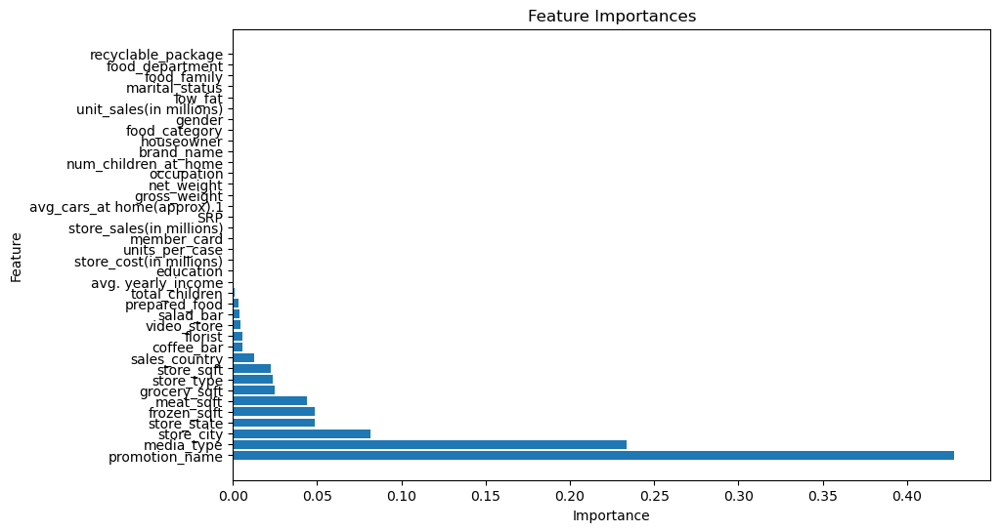

In [318]:
# Assuming best_model is your trained RandomForestRegressor model

# Get feature importances from the best model
feature_importances = best_model.feature_importances_

# Get the names of features (assuming train_data is a DataFrame)
feature_names = X_train1.columns

# Create a DataFrame to display feature importances
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': feature_importances
})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importances')
plt.show()

In [319]:
# Assuming you want to keep the top 5 features
top_n_features = 6

# Select the top N features based on importance
selected_features = feature_importance_df['Feature'][:top_n_features].tolist()

# Retain only the selected features in your data
selected_train_data = X_train1[selected_features]
selected_test_data = X_test1[selected_features]

# Retrain your model using only the selected features
model_with_selected_features = RandomForestRegressor(n_estimators=100, random_state=1)
model_with_selected_features.fit(selected_train_data, y_train1)

# Make predictions and evaluate the model
predictions_with_selected_features = model_with_selected_features.predict(selected_test_data)
mae_with_selected_features = mean_absolute_error(y_test1, predictions_with_selected_features)
print('Mean Absolute Error with Selected Features:', mae_with_selected_features)

# Access the best model's score on the training data
best_model_score_s = model_with_selected_features.score(selected_train_data, y_train1)
print(f'Best Model Score on Training Data: {best_model_score_s}')

Mean Absolute Error with Selected Features: 0.4536077511932976
Best Model Score on Training Data: 0.9908357062346911


In [320]:
from xgboost import XGBRegressor
import xgboost as xgb
from sklearn.metrics import mean_squared_error, r2_score, mean_squared_log_error

# create an xgboost regression model
model = xgb.XGBRegressor(eval_metric='rmsle')

from sklearn.model_selection import GridSearchCV
# set up our search grid
param_grid = {"max_depth":    [4, 5, 6],
              "n_estimators": [500, 600, 700],
              "learning_rate": [0.01, 0.015]}

# try out every combination of the above values
search = GridSearchCV(
    model, 
    param_grid, 
    cv=5).fit(X_train1, y_train1)

print("The best hyperparameters are ",search.best_params_)

model = xgb.XGBRegressor(learning_rate = search.best_params_["learning_rate"],
                           n_estimators  = search.best_params_["n_estimators"],
                           max_depth     = search.best_params_["max_depth"],
                           eval_metric='rmsle')

model.fit(X_train1, y_train1)
y_predict = model.predict(X_test1)

print("R Square: %.3f" % r2_score(y_test1, y_predict))
print("Mean squared error: %.3f" % mean_squared_error(y_test1, y_predict))
print("RMSE: %.3f" % mean_squared_error(y_test1, y_predict, squared=False))
print("RMSEL: %.3f" % mean_squared_log_error(y_test1, y_predict, squared=False))

The best hyperparameters are  {'learning_rate': 0.015, 'max_depth': 6, 'n_estimators': 700}
R Square: 0.955
Mean squared error: 39.943
RMSE: 6.320
RMSEL: 0.070


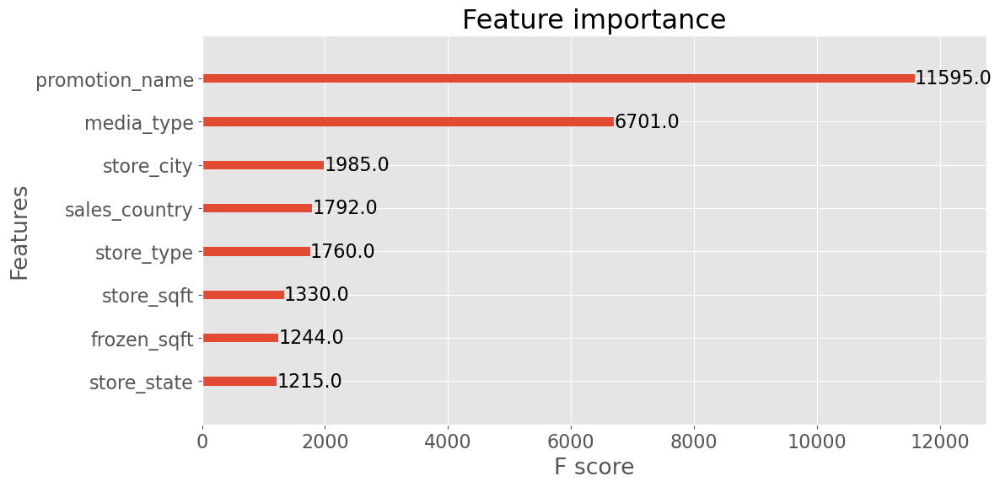

In [321]:
from xgboost import plot_importance
import matplotlib.pyplot as plt

plt.style.use('ggplot')
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(figsize=(12,6))
plot_importance(model, max_num_features=8, ax=ax)
plt.show();

In [323]:
selected_feature = ['promotion_name','media_type','store_city','sales_country','store_type','store_sqft','grocery_sqft','frozen_sqft']
X_test = df[selected_feature]

final_model = model
final_model.fit(X_train1[selected_feature], y_train1)
final_preds = final_model.predict(X_test[selected_feature])

In [324]:
final_preds

array([126.89809 ,  84.531624,  90.268875, ...,  86.9296  ,  93.022865,
        84.55632 ], dtype=float32)

In [325]:
y_test

54312     50.79
2358     143.83
8340     121.93
3714     146.41
31868     95.74
          ...  
48345     59.86
57439    116.40
35522    142.71
49380     90.77
50650     69.63
Name: cost, Length: 12086, dtype: float64

Best Parameters: {'learning_rate': 0.2, 'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 10, 'n_estimators': 100}
Best Estimator: GradientBoostingRegressor(learning_rate=0.2, max_depth=5, min_samples_leaf=2,
                          min_samples_split=10, random_state=1)
Mean Squared Error: 25.81620174682642


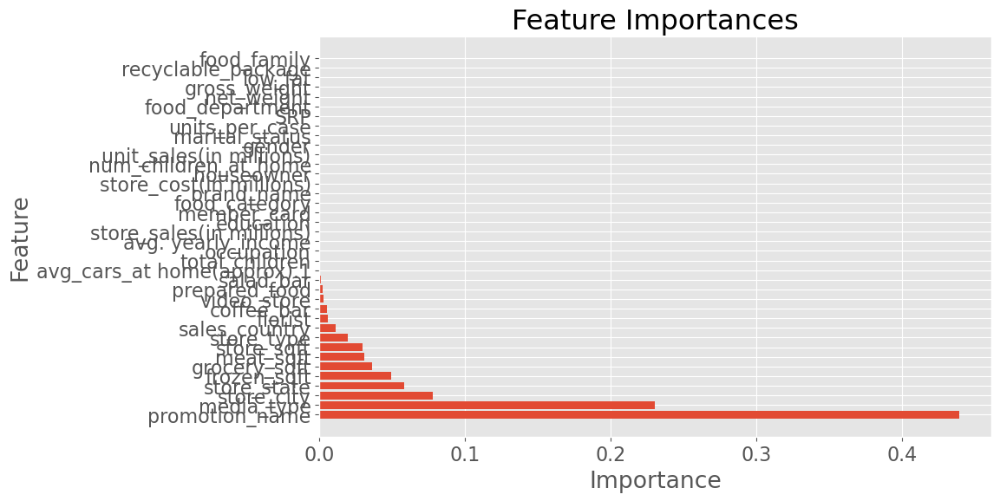

In [327]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Define the parameter grid to search
param_grid = {
    'n_estimators': [25, 50, 100],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Create the GradientBoostingRegressor
gb_regressor = GradientBoostingRegressor(random_state=1)

# Create the GridSearchCV object
grid_search = GridSearchCV(estimator=gb_regressor, param_grid=param_grid, scoring='neg_mean_squared_error', cv=3)

# Fit the GridSearchCV object to the training data
grid_search.fit(X_train1, y_train1)

# Print the best parameters and best estimator
print("Best Parameters:", grid_search.best_params_)
print("Best Estimator:", grid_search.best_estimator_)

# Make predictions on the test set using the best model
best_model = grid_search.best_estimator_
predictions = best_model.predict(X_test1)

# Evaluate the model performance
mse = mean_squared_error(y_test1, predictions)
print('Mean Squared Error:', mse)



# Assuming best_model is your trained RandomForestRegressor model

# Get feature importances from the best model
feature_importances = best_model.feature_importances_

# Get the names of features (assuming train_data is a DataFrame)
feature_names = X_train1.columns

# Create a DataFrame to display feature importances
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': feature_importances
})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot the feature importances
plt.figure(figsize=(10, 6))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importances')
plt.show()


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import StackingRegressor, RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error



base_models = [
    ('rf', make_pipeline( RandomForestRegressor(random_state=42))),
    ('gb', make_pipeline( GradientBoostingRegressor(random_state=42))),
]


meta_model = LinearRegression()


stacked_model = StackingRegressor(estimators=base_models, final_estimator=meta_model)


param_grid = {
    'final_estimator__fit_intercept': [True, False],
    'rf__randomforestregressor__n_estimators': [50, 100, 200],
    'rf__randomforestregressor__max_depth': [None, 5, 10],
    'gb__gradientboostingregressor__n_estimators': [50, 100, 200],
    'gb__gradientboostingregressor__learning_rate': [0.05, 0.1, 0.2],
    'gb__gradientboostingregressor__max_depth': [3, 5, 7],
    
}


grid_search = GridSearchCV(stacked_model, param_grid, scoring='neg_mean_squared_error', cv=5)


grid_search.fit(X_train1, y_train1)

best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_


y_pred = best_estimator.predict(X_test1)


mse = mean_squared_error(X_test1, y_pred)
print(f'Mean Squared Error: {mse}')
print('Best Parameters:', best_params)

rmse = np.sqrt(mean_squared_error(y_test1, y_pred))
print(f'Root Mean Squared Error: {rmse}')


In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeRegressor


pipeline = Pipeline([
    ('selector', SelectKBest(f_regression, k=67)),
    ('regressor', DecisionTreeRegressor(criterion='squared_error', max_depth=None, max_features='sqrt', random_state=0))
])


pipeline.fit(X_train1, y_train1)


y_pred = pipeline.predict(X_test1)


mse = mean_squared_error(y_test1, y_pred)
print(f'Mean Squared Error: {mse}')


rmse = np.sqrt(mean_squared_error(y_tes1t, y_pred))
print(f'Root Mean Squared Error: {rmse}')

print(pipeline.score(X_train1, y_train1))